In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import torch
from utils import torch_from_numpy
import datetime

bif_c = 0.1
num_iter_max=200000
alpha=0.5
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'

In [2]:
import gym
import custom_gym
env = gym.make(env_name)
s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:
seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)



from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [4]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt


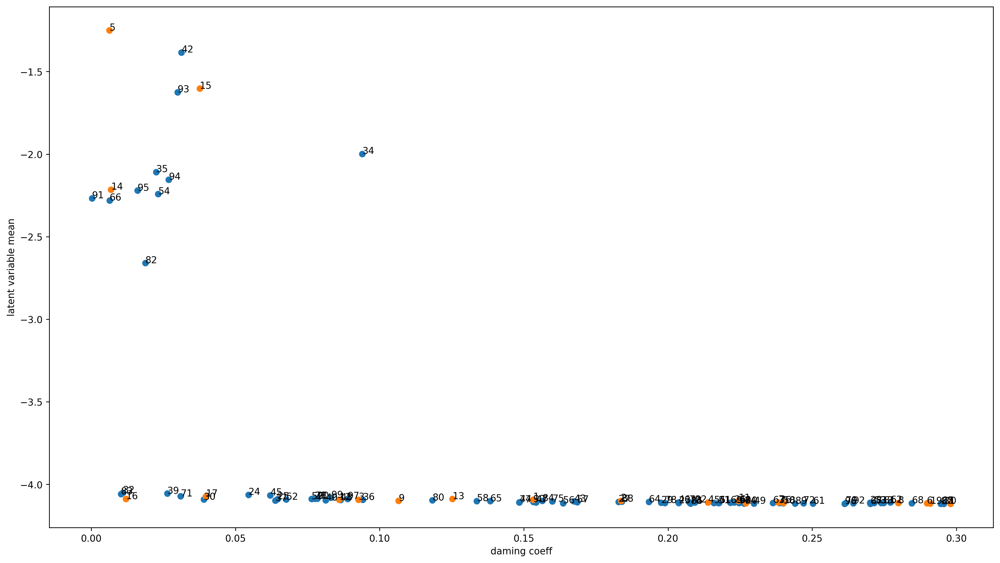

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent.png")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  1  2  3  

/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  predict diverge [   7.97626768 -546.80568074]
16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  

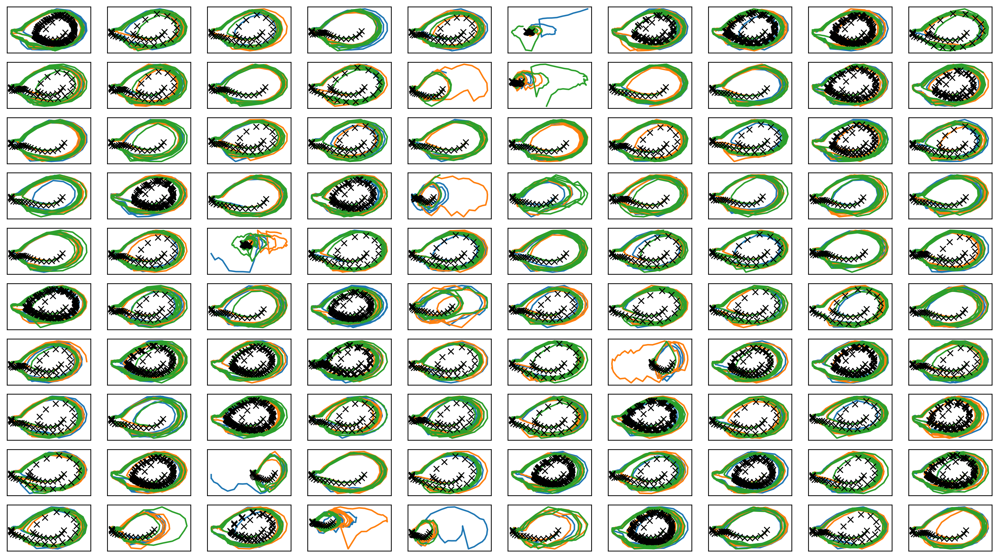

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter0.png")
print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-03-04 16:02:55.040504


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  predict diverge [  -1.29518152 -131.00773238]
6  7  8  9  10  11  12  13  14  15  predict diverge [ -0.83718392 543.38680106]
16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  predict diverge [ 52.67091888 104.48825698]
35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.38102  validloss 1.42238±0.00000  bestvalidloss 1.42238  last_update 0
train: iter 1  trainloss 1.28914  validloss 1.35662±0.00000  bestvalidloss 1.35662  last_update 0
train: iter 2  trainloss 1.01499  validloss 1.17545±0.00000  bestvalidloss 1.17545  last_update 0
train: iter 3  trainloss 0.79223  validloss 0.88045±0.00000  bestvalidloss 0.88045  last_update 0
train: iter 4  trainloss 0.67670  validloss 0.73156±0.00000  bestvalidloss 0.73156  last_update 0
train: iter 5  trainloss 0.60257  validloss 0.64485±0.00000  bestvalidloss 0.64485  last_update 0
train: iter 6  trainloss 0.54891  validloss 0.58551±0.00000  bestvalidloss 0.58551  last_update 0
train: iter 7  trainloss 0.50196  validloss 0.53492±0.00000  bestvalidloss 0.53492  last_update 0
train: iter 8  trainloss 0.46343  validloss 0.49275±0.00000  bestvalidloss 0.49275  last_update 0
train: iter 9  trainloss 0.42950  validloss 0.45656±0.00000  bestvalidloss 0.45656  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.18281  validloss 0.29885±0.00000  bestvalidloss 0.27842  last_update 22
train: iter 85  trainloss 0.18251  validloss 0.28811±0.00000  bestvalidloss 0.27842  last_update 23
train: iter 86  trainloss 0.18329  validloss 0.29827±0.00000  bestvalidloss 0.27842  last_update 24
train: iter 87  trainloss 0.18018  validloss 0.29074±0.00000  bestvalidloss 0.27842  last_update 25
train: iter 88  trainloss 0.18097  validloss 0.30524±0.00000  bestvalidloss 0.27842  last_update 26
train: iter 89  trainloss 0.18032  validloss 0.28921±0.00000  bestvalidloss 0.27842  last_update 27
train: iter 90  trainloss 0.18018  validloss 0.29385±0.00000  bestvalidloss 0.27842  last_update 28
train: iter 91  trainloss 0.17990  validloss 0.28698±0.00000  bestvalidloss 0.27842  last_update 29
train: iter 92  trainloss 0.18055  validloss 0.28467±0.00000  bestvalidloss 0.27842  last_update 30
train: iter 93  trainloss 0.17777  validloss 0.31136±0.00000  bestvalidloss 0.27842  last_update 31


train: iter 168  trainloss 0.16020  validloss 0.30612±0.00000  bestvalidloss 0.27644  last_update 6
train: iter 169  trainloss 0.16094  validloss 0.28938±0.00000  bestvalidloss 0.27644  last_update 7
train: iter 170  trainloss 0.15926  validloss 0.28162±0.00000  bestvalidloss 0.27644  last_update 8
train: iter 171  trainloss 0.15796  validloss 0.28438±0.00000  bestvalidloss 0.27644  last_update 9
train: iter 172  trainloss 0.16302  validloss 0.29426±0.00000  bestvalidloss 0.27644  last_update 10
train: iter 173  trainloss 0.16246  validloss 0.30511±0.00000  bestvalidloss 0.27644  last_update 11
train: iter 174  trainloss 0.16081  validloss 0.29056±0.00000  bestvalidloss 0.27644  last_update 12
train: iter 175  trainloss 0.15831  validloss 0.28192±0.00000  bestvalidloss 0.27644  last_update 13
train: iter 176  trainloss 0.15752  validloss 0.28192±0.00000  bestvalidloss 0.27644  last_update 14
train: iter 177  trainloss 0.16014  validloss 0.27860±0.00000  bestvalidloss 0.27644  last_upda

train: iter 253  trainloss 0.14884  validloss 0.26075±0.00000  bestvalidloss 0.25650  last_update 4
train: iter 254  trainloss 0.14710  validloss 0.27288±0.00000  bestvalidloss 0.25650  last_update 5
train: iter 255  trainloss 0.15036  validloss 0.26707±0.00000  bestvalidloss 0.25650  last_update 6
train: iter 256  trainloss 0.14730  validloss 0.25534±0.00000  bestvalidloss 0.25534  last_update 0
train: iter 257  trainloss 0.14886  validloss 0.26404±0.00000  bestvalidloss 0.25534  last_update 1
train: iter 258  trainloss 0.14951  validloss 0.25758±0.00000  bestvalidloss 0.25534  last_update 2
train: iter 259  trainloss 0.14795  validloss 0.26612±0.00000  bestvalidloss 0.25534  last_update 3
train: iter 260  trainloss 0.14981  validloss 0.26144±0.00000  bestvalidloss 0.25534  last_update 4
train: iter 261  trainloss 0.14730  validloss 0.25891±0.00000  bestvalidloss 0.25534  last_update 5
train: iter 262  trainloss 0.14767  validloss 0.26134±0.00000  bestvalidloss 0.25534  last_update 6


train: iter 335  trainloss 0.14159  validloss 0.25102±0.00000  bestvalidloss 0.23781  last_update 9
train: iter 336  trainloss 0.14118  validloss 0.24300±0.00000  bestvalidloss 0.23781  last_update 10
train: iter 337  trainloss 0.14211  validloss 0.24644±0.00000  bestvalidloss 0.23781  last_update 11
train: iter 338  trainloss 0.14320  validloss 0.24697±0.00000  bestvalidloss 0.23781  last_update 12
train: iter 339  trainloss 0.14168  validloss 0.24696±0.00000  bestvalidloss 0.23781  last_update 13
train: iter 340  trainloss 0.14072  validloss 0.24224±0.00000  bestvalidloss 0.23781  last_update 14
train: iter 341  trainloss 0.13973  validloss 0.24483±0.00000  bestvalidloss 0.23781  last_update 15
train: iter 342  trainloss 0.13938  validloss 0.24361±0.00000  bestvalidloss 0.23781  last_update 16
train: iter 343  trainloss 0.13983  validloss 0.25452±0.00000  bestvalidloss 0.23781  last_update 17
train: iter 344  trainloss 0.14220  validloss 0.25434±0.00000  bestvalidloss 0.23781  last_u

train: iter 420  trainloss 0.13416  validloss 0.24480±0.00000  bestvalidloss 0.23597  last_update 36
train: iter 421  trainloss 0.13273  validloss 0.25073±0.00000  bestvalidloss 0.23597  last_update 37
train: iter 422  trainloss 0.13269  validloss 0.24780±0.00000  bestvalidloss 0.23597  last_update 38
train: iter 423  trainloss 0.13584  validloss 0.24848±0.00000  bestvalidloss 0.23597  last_update 39
train: iter 424  trainloss 0.13461  validloss 0.24489±0.00000  bestvalidloss 0.23597  last_update 40
train: iter 425  trainloss 0.13558  validloss 0.24975±0.00000  bestvalidloss 0.23597  last_update 41
train: iter 426  trainloss 0.13396  validloss 0.25002±0.00000  bestvalidloss 0.23597  last_update 42
train: iter 427  trainloss 0.13555  validloss 0.24848±0.00000  bestvalidloss 0.23597  last_update 43
train: iter 428  trainloss 0.13601  validloss 0.24984±0.00000  bestvalidloss 0.23597  last_update 44
train: iter 429  trainloss 0.13412  validloss 0.24409±0.00000  bestvalidloss 0.23597  last_

In [12]:
iwvi.eval_loss(weight_alpha=alpha)

train_loss:  -96.32426825344564
valid_loss:  -133.3474481034279


1e-08 1000.0


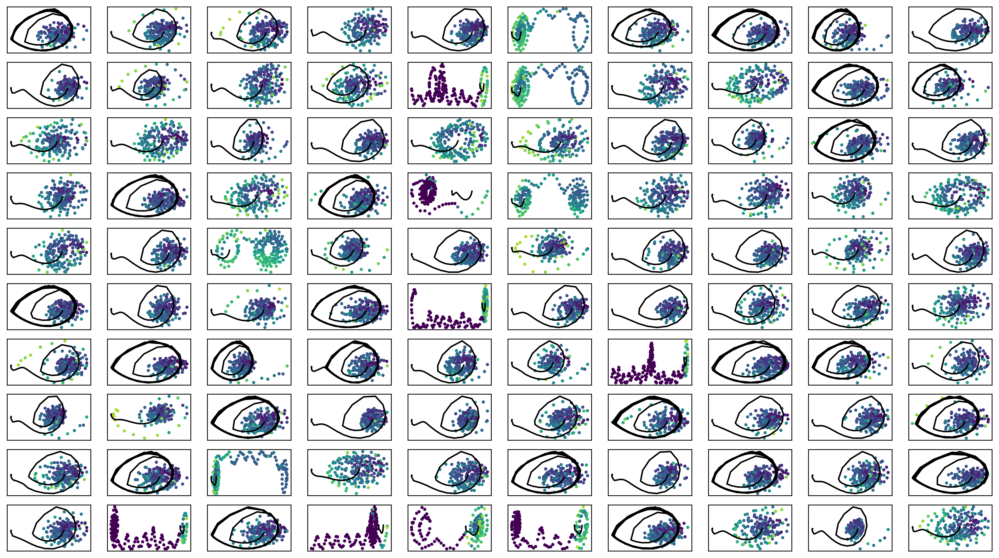

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -30.68654  validloss -41.66402±0.00000  bestvalidloss -41.66402  last_update 0
train: iter 1  trainloss -35.92382  validloss -32.83380±0.00000  bestvalidloss -41.66402  last_update 1
train: iter 2  trainloss -40.11123  validloss -35.56108±0.00000  bestvalidloss -41.66402  last_update 2
train: iter 3  trainloss -42.84009  validloss -37.20982±0.00000  bestvalidloss -41.66402  last_update 3
train: iter 4  trainloss -44.56086  validloss -37.46879±0.00000  bestvalidloss -41.66402  last_update 4
train: iter 5  trainloss -45.65056  validloss -39.77991±0.00000  bestvalidloss -41.66402  last_update 5
train: iter 6  trainloss -46.37840  validloss -30.14721±0.00000  bestvalidloss -41.66402  last_update 6
train: iter 7  trainloss -40.68706  validloss -39.54231±0.00000  bestvalidloss -41.66402  last_update 7
train: iter 8  trainloss -43.57138  validloss -26.78952±0.00000  bestvalidloss -41.66402  last_update 8
train: iter 9  trainloss -48.70678  

train: iter 78  trainloss -135.01162  validloss -144.65774±0.00000  bestvalidloss -256.15614  last_update 13
train: iter 79  trainloss -110.65237  validloss -93.18422±0.00000  bestvalidloss -256.15614  last_update 14
train: iter 80  trainloss -147.52556  validloss -102.34380±0.00000  bestvalidloss -256.15614  last_update 15
train: iter 81  trainloss -150.71341  validloss -98.43556±0.00000  bestvalidloss -256.15614  last_update 16
train: iter 82  trainloss -148.84109  validloss -84.35171±0.00000  bestvalidloss -256.15614  last_update 17
train: iter 83  trainloss -134.37514  validloss -125.13516±0.00000  bestvalidloss -256.15614  last_update 18
train: iter 84  trainloss -143.49451  validloss -127.39759±0.00000  bestvalidloss -256.15614  last_update 19
train: iter 85  trainloss -156.33248  validloss -152.32826±0.00000  bestvalidloss -256.15614  last_update 20
train: iter 86  trainloss -149.97331  validloss -124.86481±0.00000  bestvalidloss -256.15614  last_update 21
train: iter 87  trainl

train: iter 153  trainloss -133.77906  validloss -114.66789±0.00000  bestvalidloss -256.15614  last_update 88
train: iter 154  trainloss -123.07024  validloss -101.52613±0.00000  bestvalidloss -256.15614  last_update 89
train: iter 155  trainloss -139.19182  validloss -109.38779±0.00000  bestvalidloss -256.15614  last_update 90
train: iter 156  trainloss -136.81101  validloss -149.67581±0.00000  bestvalidloss -256.15614  last_update 91
train: iter 157  trainloss -115.15592  validloss -118.34143±0.00000  bestvalidloss -256.15614  last_update 92
train: iter 158  trainloss -136.37265  validloss -108.08124±0.00000  bestvalidloss -256.15614  last_update 93
train: iter 159  trainloss -134.60957  validloss -130.75759±0.00000  bestvalidloss -256.15614  last_update 94
train: iter 160  trainloss -130.74747  validloss -146.39007±0.00000  bestvalidloss -256.15614  last_update 95
train: iter 161  trainloss -128.64542  validloss -137.18985±0.00000  bestvalidloss -256.15614  last_update 96
train: ite

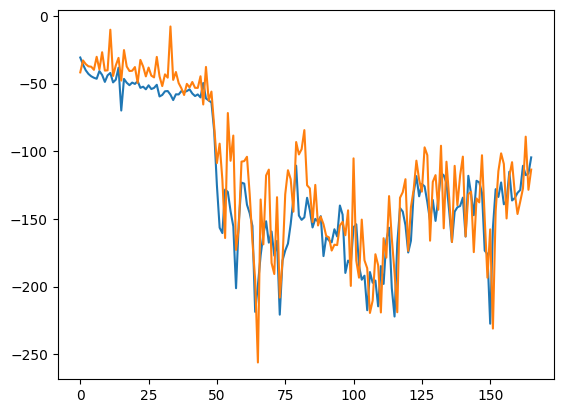

train_weighted_vae: enc
train: iter 0  trainloss -119.94990  validloss -129.47453±0.00000  bestvalidloss -129.47453  last_update 0
train: iter 1  trainloss -118.19924  validloss -130.99061±0.00000  bestvalidloss -130.99061  last_update 0
train: iter 2  trainloss -109.01576  validloss -124.25140±0.00000  bestvalidloss -130.99061  last_update 1
train: iter 3  trainloss -106.62621  validloss -110.52249±0.00000  bestvalidloss -130.99061  last_update 2
train: iter 4  trainloss -102.61380  validloss -117.94111±0.00000  bestvalidloss -130.99061  last_update 3
train: iter 5  trainloss -89.13152  validloss -98.56262±0.00000  bestvalidloss -130.99061  last_update 4
train: iter 6  trainloss -88.62136  validloss -99.68177±0.00000  bestvalidloss -130.99061  last_update 5
train: iter 7  trainloss -91.99730  validloss -99.72950±0.00000  bestvalidloss -130.99061  last_update 6
train: iter 8  trainloss -93.85393  validloss -103.51375±0.00000  bestvalidloss -130.99061  last_update 7
train: iter 9  train

train: iter 76  trainloss -106.08369  validloss -104.69007±0.00000  bestvalidloss -219.14333  last_update 23
train: iter 77  trainloss -110.94408  validloss -107.63844±0.00000  bestvalidloss -219.14333  last_update 24
train: iter 78  trainloss -115.98282  validloss -121.83819±0.00000  bestvalidloss -219.14333  last_update 25
train: iter 79  trainloss -121.31598  validloss -128.54799±0.00000  bestvalidloss -219.14333  last_update 26
train: iter 80  trainloss -117.96532  validloss -126.57005±0.00000  bestvalidloss -219.14333  last_update 27
train: iter 81  trainloss -126.43808  validloss -129.97581±0.00000  bestvalidloss -219.14333  last_update 28
train: iter 82  trainloss -139.82232  validloss -128.66412±0.00000  bestvalidloss -219.14333  last_update 29
train: iter 83  trainloss -152.00076  validloss -152.95745±0.00000  bestvalidloss -219.14333  last_update 30
train: iter 84  trainloss -127.66176  validloss -132.87305±0.00000  bestvalidloss -219.14333  last_update 31
train: iter 85  tra

train: iter 151  trainloss -114.84513  validloss -127.29433±0.00000  bestvalidloss -219.14333  last_update 98
train: iter 152  trainloss -115.80992  validloss -126.04395±0.00000  bestvalidloss -219.14333  last_update 99
train: iter 153  trainloss -119.13461  validloss -120.85786±0.00000  bestvalidloss -219.14333  last_update 100
train: fin


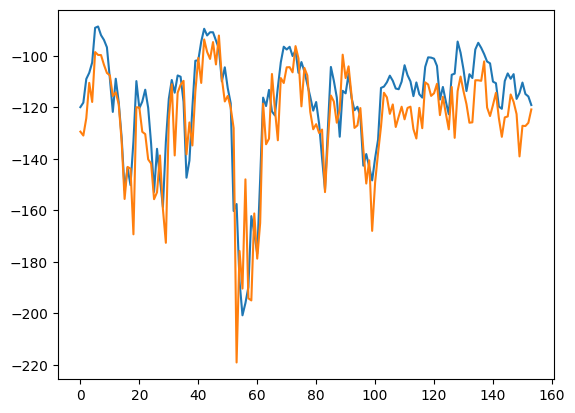

train_weighted_vae: dec
train: iter 0  trainloss -132.61224  validloss -131.56825±0.00000  bestvalidloss -131.56825  last_update 0
train: iter 1  trainloss -134.70873  validloss -151.02893±0.00000  bestvalidloss -151.02893  last_update 0
train: iter 2  trainloss -132.49030  validloss -151.72225±0.00000  bestvalidloss -151.72225  last_update 0
train: iter 3  trainloss -136.18029  validloss -144.17450±0.00000  bestvalidloss -151.72225  last_update 1
train: iter 4  trainloss -133.50991  validloss -146.92408±0.00000  bestvalidloss -151.72225  last_update 2
train: iter 5  trainloss -137.39503  validloss -144.46521±0.00000  bestvalidloss -151.72225  last_update 3
train: iter 6  trainloss -134.76390  validloss -147.64349±0.00000  bestvalidloss -151.72225  last_update 4
train: iter 7  trainloss -134.63428  validloss -149.51713±0.00000  bestvalidloss -151.72225  last_update 5
train: iter 8  trainloss -130.73618  validloss -135.34387±0.00000  bestvalidloss -151.72225  last_update 6
train: iter 9

train: iter 76  trainloss -142.86554  validloss -133.10533±0.00000  bestvalidloss -159.79360  last_update 29
train: iter 77  trainloss -144.68083  validloss -145.51553±0.00000  bestvalidloss -159.79360  last_update 30
train: iter 78  trainloss -147.62636  validloss -151.39660±0.00000  bestvalidloss -159.79360  last_update 31
train: iter 79  trainloss -144.26101  validloss -141.02141±0.00000  bestvalidloss -159.79360  last_update 32
train: iter 80  trainloss -143.22186  validloss -144.76166±0.00000  bestvalidloss -159.79360  last_update 33
train: iter 81  trainloss -150.12390  validloss -153.84287±0.00000  bestvalidloss -159.79360  last_update 34
train: iter 82  trainloss -148.30095  validloss -150.59514±0.00000  bestvalidloss -159.79360  last_update 35
train: iter 83  trainloss -146.95961  validloss -140.73446±0.00000  bestvalidloss -159.79360  last_update 36
train: iter 84  trainloss -148.02208  validloss -145.28870±0.00000  bestvalidloss -159.79360  last_update 37
train: iter 85  tra

train: iter 153  trainloss -147.15450  validloss -130.87575±0.00000  bestvalidloss -164.58111  last_update 48
train: iter 154  trainloss -150.37172  validloss -148.76105±0.00000  bestvalidloss -164.58111  last_update 49
train: iter 155  trainloss -152.03060  validloss -144.26589±0.00000  bestvalidloss -164.58111  last_update 50
train: iter 156  trainloss -153.70480  validloss -154.15253±0.00000  bestvalidloss -164.58111  last_update 51
train: iter 157  trainloss -153.69672  validloss -156.89552±0.00000  bestvalidloss -164.58111  last_update 52
train: iter 158  trainloss -146.08437  validloss -142.92553±0.00000  bestvalidloss -164.58111  last_update 53
train: iter 159  trainloss -152.16975  validloss -151.88429±0.00000  bestvalidloss -164.58111  last_update 54
train: iter 160  trainloss -141.14971  validloss -149.95257±0.00000  bestvalidloss -164.58111  last_update 55
train: iter 161  trainloss -150.51727  validloss -156.75011±0.00000  bestvalidloss -164.58111  last_update 56
train: ite

train: iter 230  trainloss -152.22171  validloss -158.62130±0.00000  bestvalidloss -168.98791  last_update 15
train: iter 231  trainloss -153.41629  validloss -166.62468±0.00000  bestvalidloss -168.98791  last_update 16
train: iter 232  trainloss -153.03779  validloss -134.93031±0.00000  bestvalidloss -168.98791  last_update 17
train: iter 233  trainloss -149.42255  validloss -160.27613±0.00000  bestvalidloss -168.98791  last_update 18
train: iter 234  trainloss -153.68745  validloss -155.82659±0.00000  bestvalidloss -168.98791  last_update 19
train: iter 235  trainloss -153.34655  validloss -156.84738±0.00000  bestvalidloss -168.98791  last_update 20
train: iter 236  trainloss -153.82426  validloss -163.31391±0.00000  bestvalidloss -168.98791  last_update 21
train: iter 237  trainloss -147.36073  validloss -163.89374±0.00000  bestvalidloss -168.98791  last_update 22
train: iter 238  trainloss -142.09774  validloss -160.34911±0.00000  bestvalidloss -168.98791  last_update 23
train: ite

train: iter 306  trainloss -156.76279  validloss -157.53923±0.00000  bestvalidloss -168.98791  last_update 91
train: iter 307  trainloss -157.19393  validloss -154.89371±0.00000  bestvalidloss -168.98791  last_update 92
train: iter 308  trainloss -152.66014  validloss -151.90511±0.00000  bestvalidloss -168.98791  last_update 93
train: iter 309  trainloss -155.32734  validloss -167.02184±0.00000  bestvalidloss -168.98791  last_update 94
train: iter 310  trainloss -154.84066  validloss -160.73120±0.00000  bestvalidloss -168.98791  last_update 95
train: iter 311  trainloss -157.00688  validloss -131.05475±0.00000  bestvalidloss -168.98791  last_update 96
train: iter 312  trainloss -150.65709  validloss -153.32537±0.00000  bestvalidloss -168.98791  last_update 97
train: iter 313  trainloss -156.01282  validloss -151.38725±0.00000  bestvalidloss -168.98791  last_update 98
train: iter 314  trainloss -153.71889  validloss -139.58490±0.00000  bestvalidloss -168.98791  last_update 99
train: ite

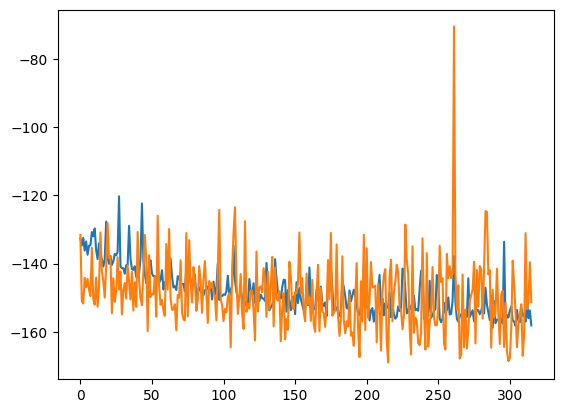

alpha 0.5 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

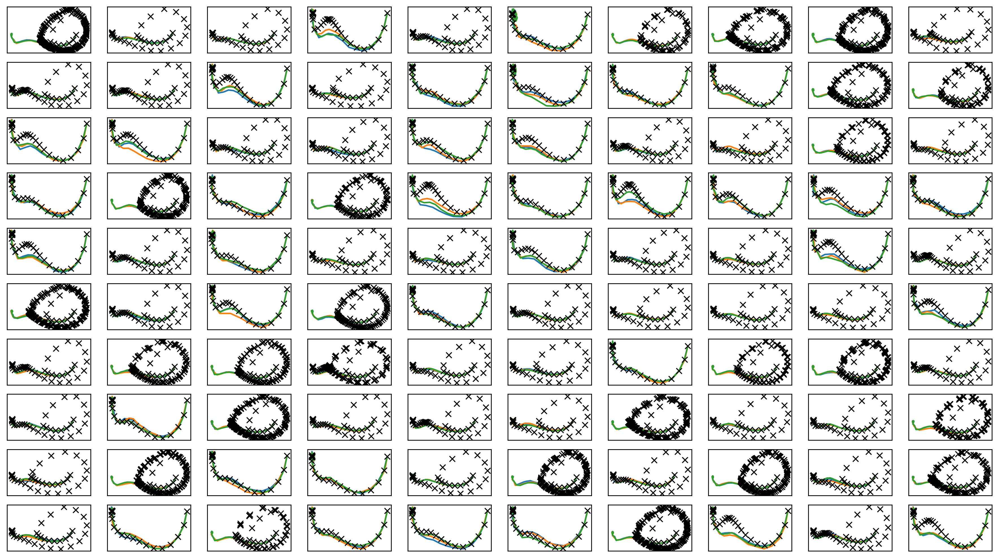

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter1.png")
print("実環境方策rollout vs Sim環境方策rollout")

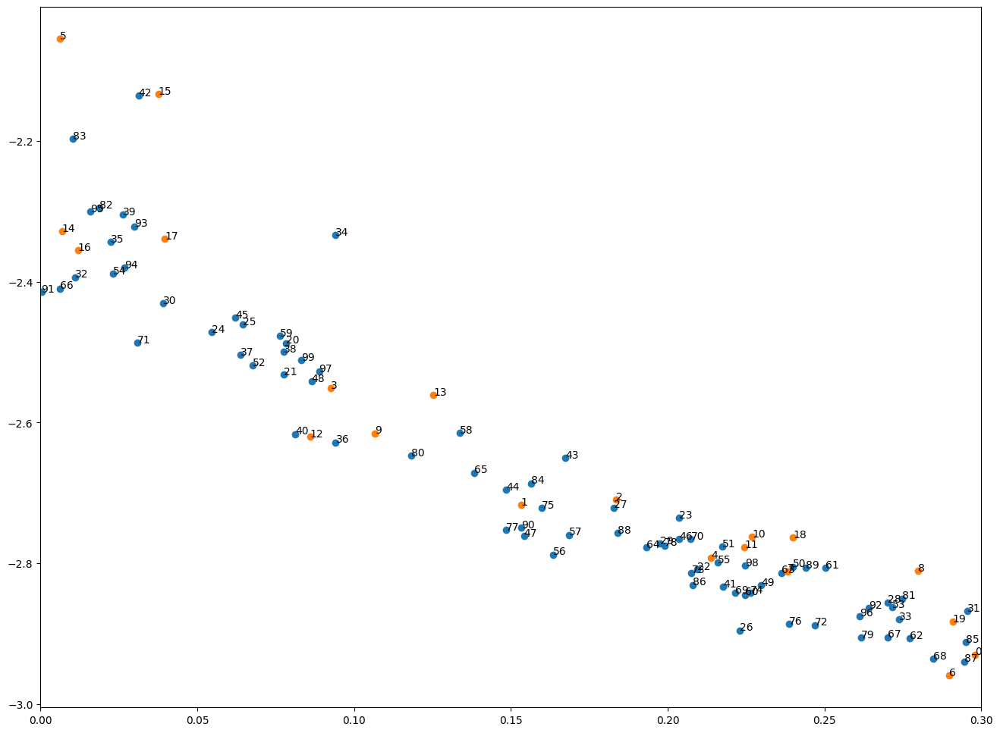

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-03-04 16:06:19.824376


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.09918  validloss 0.18666±0.00000  bestvalidloss 0.18666  last_update 0
train: iter 1  trainloss 0.07246  validloss 0.10128±0.00000  bestvalidloss 0.10128  last_update 0
train: iter 2  trainloss 0.06117  validloss 0.07786±0.00000  bestvalidloss 0.07786  last_update 0
train: iter 3  trainloss 0.05475  validloss 0.06823±0.00000  bestvalidloss 0.06823  last_update 0
train: iter 4  trainloss 0.05209  validloss 0.05952±0.00000  bestvalidloss 0.05952  last_update 0
train: iter 5  trainloss 0.04965  validloss 0.05640±0.00000  bestvalidloss 0.05640  last_update 0
train: iter 6  trainloss 0.05081  validloss 0.05571±0.00000  bestvalidloss 0.05571  last_update 0
train: iter 7  trainloss 0.04876  validloss 0.05480±0.00000  bestvalidloss 0.05480  last_update 0
train: iter 8  trainloss 0.04798  validloss 0.05426±0.00000  bestvalidloss 0.05426  last_update 0
train: iter 9  trainloss 0.04790  validloss 0.05306±0.00000  bestvalidloss 0.05306  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.03710  validloss 0.04713±0.00000  bestvalidloss 0.04161  last_update 4
train: iter 84  trainloss 0.03479  validloss 0.04494±0.00000  bestvalidloss 0.04161  last_update 5
train: iter 85  trainloss 0.03591  validloss 0.04582±0.00000  bestvalidloss 0.04161  last_update 6
train: iter 86  trainloss 0.03608  validloss 0.04755±0.00000  bestvalidloss 0.04161  last_update 7
train: iter 87  trainloss 0.03584  validloss 0.04964±0.00000  bestvalidloss 0.04161  last_update 8
train: iter 88  trainloss 0.03374  validloss 0.04124±0.00000  bestvalidloss 0.04124  last_update 0
train: iter 89  trainloss 0.03334  validloss 0.03999±0.00000  bestvalidloss 0.03999  last_update 0
train: iter 90  trainloss 0.03424  validloss 0.04063±0.00000  bestvalidloss 0.03999  last_update 1
train: iter 91  trainloss 0.03576  validloss 0.04475±0.00000  bestvalidloss 0.03999  last_update 2
train: iter 92  trainloss 0.03418  validloss 0.04856±0.00000  bestvalidloss 0.03999  last_update 3
train: ite

train: iter 169  trainloss 0.02804  validloss 0.04841±0.00000  bestvalidloss 0.03528  last_update 2
train: iter 170  trainloss 0.02757  validloss 0.03564±0.00000  bestvalidloss 0.03528  last_update 3
train: iter 171  trainloss 0.02829  validloss 0.03885±0.00000  bestvalidloss 0.03528  last_update 4
train: iter 172  trainloss 0.02881  validloss 0.03610±0.00000  bestvalidloss 0.03528  last_update 5
train: iter 173  trainloss 0.02851  validloss 0.03664±0.00000  bestvalidloss 0.03528  last_update 6
train: iter 174  trainloss 0.02787  validloss 0.03843±0.00000  bestvalidloss 0.03528  last_update 7
train: iter 175  trainloss 0.03220  validloss 0.03948±0.00000  bestvalidloss 0.03528  last_update 8
train: iter 176  trainloss 0.03045  validloss 0.04031±0.00000  bestvalidloss 0.03528  last_update 9
train: iter 177  trainloss 0.02897  validloss 0.03700±0.00000  bestvalidloss 0.03528  last_update 10
train: iter 178  trainloss 0.03035  validloss 0.04241±0.00000  bestvalidloss 0.03528  last_update 1

train: iter 254  trainloss 0.02772  validloss 0.03398±0.00000  bestvalidloss 0.03253  last_update 8
train: iter 255  trainloss 0.02594  validloss 0.03914±0.00000  bestvalidloss 0.03253  last_update 9
train: iter 256  trainloss 0.02567  validloss 0.03402±0.00000  bestvalidloss 0.03253  last_update 10
train: iter 257  trainloss 0.02531  validloss 0.03789±0.00000  bestvalidloss 0.03253  last_update 11
train: iter 258  trainloss 0.02504  validloss 0.03619±0.00000  bestvalidloss 0.03253  last_update 12
train: iter 259  trainloss 0.02904  validloss 0.04333±0.00000  bestvalidloss 0.03253  last_update 13
train: iter 260  trainloss 0.02938  validloss 0.03425±0.00000  bestvalidloss 0.03253  last_update 14
train: iter 261  trainloss 0.02552  validloss 0.04513±0.00000  bestvalidloss 0.03253  last_update 15
train: iter 262  trainloss 0.03137  validloss 0.03414±0.00000  bestvalidloss 0.03253  last_update 16
train: iter 263  trainloss 0.02540  validloss 0.03806±0.00000  bestvalidloss 0.03253  last_up

train: iter 338  trainloss 0.02869  validloss 0.03481±0.00000  bestvalidloss 0.03026  last_update 2
train: iter 339  trainloss 0.02385  validloss 0.03169±0.00000  bestvalidloss 0.03026  last_update 3
train: iter 340  trainloss 0.02540  validloss 0.03312±0.00000  bestvalidloss 0.03026  last_update 4
train: iter 341  trainloss 0.02425  validloss 0.03405±0.00000  bestvalidloss 0.03026  last_update 5
train: iter 342  trainloss 0.02428  validloss 0.03076±0.00000  bestvalidloss 0.03026  last_update 6
train: iter 343  trainloss 0.02374  validloss 0.03090±0.00000  bestvalidloss 0.03026  last_update 7
train: iter 344  trainloss 0.02381  validloss 0.03299±0.00000  bestvalidloss 0.03026  last_update 8
train: iter 345  trainloss 0.02405  validloss 0.03405±0.00000  bestvalidloss 0.03026  last_update 9
train: iter 346  trainloss 0.02431  validloss 0.03920±0.00000  bestvalidloss 0.03026  last_update 10
train: iter 347  trainloss 0.02636  validloss 0.03707±0.00000  bestvalidloss 0.03026  last_update 1

train: iter 423  trainloss 0.02262  validloss 0.03013±0.00000  bestvalidloss 0.02897  last_update 23
train: iter 424  trainloss 0.02664  validloss 0.02995±0.00000  bestvalidloss 0.02897  last_update 24
train: iter 425  trainloss 0.02277  validloss 0.03013±0.00000  bestvalidloss 0.02897  last_update 25
train: iter 426  trainloss 0.02425  validloss 0.03013±0.00000  bestvalidloss 0.02897  last_update 26
train: iter 427  trainloss 0.02384  validloss 0.05813±0.00000  bestvalidloss 0.02897  last_update 27
train: iter 428  trainloss 0.02285  validloss 0.03182±0.00000  bestvalidloss 0.02897  last_update 28
train: iter 429  trainloss 0.02397  validloss 0.02966±0.00000  bestvalidloss 0.02897  last_update 29
train: iter 430  trainloss 0.02191  validloss 0.03682±0.00000  bestvalidloss 0.02897  last_update 30
train: iter 431  trainloss 0.02153  validloss 0.03046±0.00000  bestvalidloss 0.02897  last_update 31
train: iter 432  trainloss 0.02941  validloss 0.03304±0.00000  bestvalidloss 0.02897  last_

train: iter 506  trainloss 0.02194  validloss 0.02776±0.00000  bestvalidloss 0.02686  last_update 41
train: iter 507  trainloss 0.02080  validloss 0.03372±0.00000  bestvalidloss 0.02686  last_update 42
train: iter 508  trainloss 0.02073  validloss 0.03372±0.00000  bestvalidloss 0.02686  last_update 43
train: iter 509  trainloss 0.02168  validloss 0.03230±0.00000  bestvalidloss 0.02686  last_update 44
train: iter 510  trainloss 0.02166  validloss 0.03267±0.00000  bestvalidloss 0.02686  last_update 45
train: iter 511  trainloss 0.02312  validloss 0.03116±0.00000  bestvalidloss 0.02686  last_update 46
train: iter 512  trainloss 0.02184  validloss 0.02933±0.00000  bestvalidloss 0.02686  last_update 47
train: iter 513  trainloss 0.02407  validloss 0.03019±0.00000  bestvalidloss 0.02686  last_update 48
train: iter 514  trainloss 0.02127  validloss 0.03969±0.00000  bestvalidloss 0.02686  last_update 49
train: iter 515  trainloss 0.02099  validloss 0.03092±0.00000  bestvalidloss 0.02686  last_

In [23]:
iwvi.eval_loss(weight_alpha=alpha)

train_loss:  -45.162903295755385
valid_loss:  -30.292416265010836


1e-08 1000.0


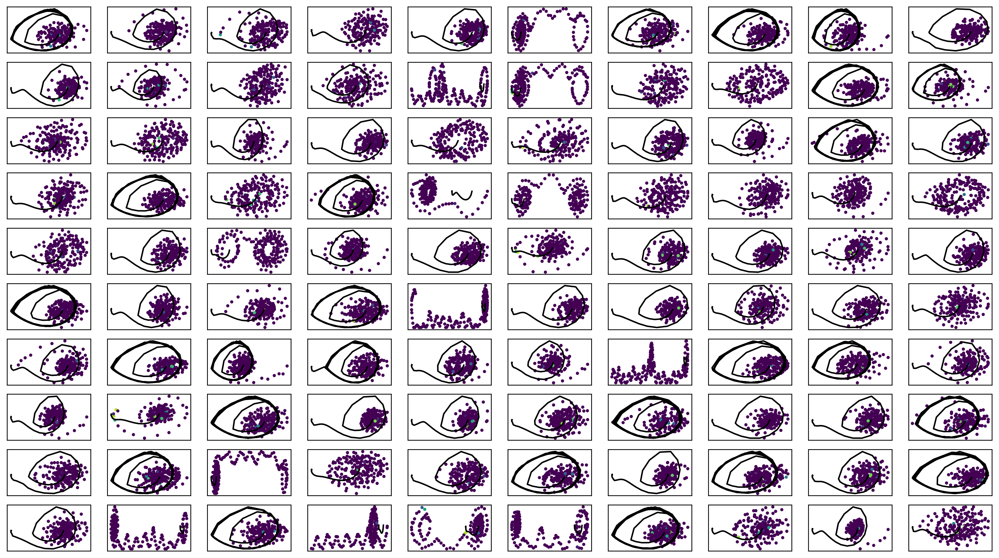

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -18.22775  validloss -3.01573±0.00000  bestvalidloss -3.01573  last_update 0
train: iter 1  trainloss -40.32629  validloss -25.82966±0.00000  bestvalidloss -25.82966  last_update 0
train: iter 2  trainloss -61.64727  validloss -50.95020±0.00000  bestvalidloss -50.95020  last_update 0
train: iter 3  trainloss -34.08873  validloss -18.61645±0.00000  bestvalidloss -50.95020  last_update 1
train: iter 4  trainloss -37.87839  validloss -74.45261±0.00000  bestvalidloss -74.45261  last_update 0
train: iter 5  trainloss 4.77527  validloss -17.76237±0.00000  bestvalidloss -74.45261  last_update 1
train: iter 6  trainloss -29.14417  validloss -41.62533±0.00000  bestvalidloss -74.45261  last_update 2
train: iter 7  trainloss 0.79050  validloss -14.23121±0.00000  bestvalidloss -74.45261  last_update 3
train: iter 8  trainloss -3.92524  validloss -31.37699±0.00000  bestvalidloss -74.45261  last_update 4
train: iter 9  trainloss 32.91090  validlos

train: iter 80  trainloss 6.28471  validloss -2.21357±0.00000  bestvalidloss -74.45261  last_update 76
train: iter 81  trainloss -3.79768  validloss -3.72595±0.00000  bestvalidloss -74.45261  last_update 77
train: iter 82  trainloss 5.24279  validloss -7.98754±0.00000  bestvalidloss -74.45261  last_update 78
train: iter 83  trainloss 16.68351  validloss 6.11563±0.00000  bestvalidloss -74.45261  last_update 79
train: iter 84  trainloss 2.01360  validloss 8.05354±0.00000  bestvalidloss -74.45261  last_update 80
train: iter 85  trainloss 1.87066  validloss 0.77893±0.00000  bestvalidloss -74.45261  last_update 81
train: iter 86  trainloss 2.46298  validloss 0.37597±0.00000  bestvalidloss -74.45261  last_update 82
train: iter 87  trainloss 8.39111  validloss 0.89268±0.00000  bestvalidloss -74.45261  last_update 83
train: iter 88  trainloss 1.33579  validloss 1.81831±0.00000  bestvalidloss -74.45261  last_update 84
train: iter 89  trainloss 4.81639  validloss 1.46184±0.00000  bestvalidloss -

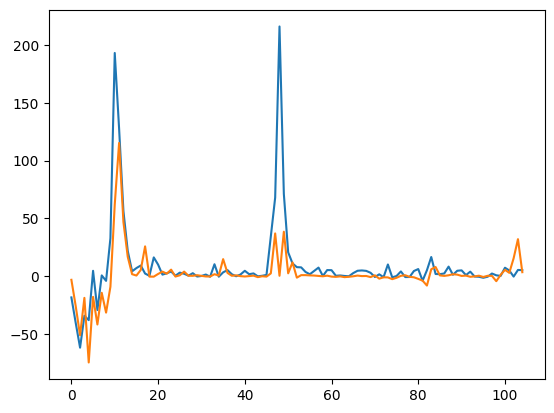

train_weighted_vae: enc
train: iter 0  trainloss 9.53578  validloss 4.61300±0.00000  bestvalidloss 4.61300  last_update 0
train: iter 1  trainloss 1.30613  validloss 4.65750±0.00000  bestvalidloss 4.61300  last_update 1
train: iter 2  trainloss 1.50622  validloss 0.89509±0.00000  bestvalidloss 0.89509  last_update 0
train: iter 3  trainloss -0.87157  validloss 1.04354±0.00000  bestvalidloss 0.89509  last_update 1
train: iter 4  trainloss 3.07895  validloss -0.44614±0.00000  bestvalidloss -0.44614  last_update 0
train: iter 5  trainloss 9.89345  validloss -0.17890±0.00000  bestvalidloss -0.44614  last_update 1
train: iter 6  trainloss -0.31361  validloss -0.00374±0.00000  bestvalidloss -0.44614  last_update 2
train: iter 7  trainloss -0.40642  validloss 0.39030±0.00000  bestvalidloss -0.44614  last_update 3
train: iter 8  trainloss -0.69367  validloss -0.04900±0.00000  bestvalidloss -0.44614  last_update 4
train: iter 9  trainloss -0.88480  validloss 0.01890±0.00000  bestvalidloss -0.44

train: iter 81  trainloss 2.07320  validloss 18.52432±0.00000  bestvalidloss -23.71561  last_update 26
train: iter 82  trainloss -0.13500  validloss 4.86988±0.00000  bestvalidloss -23.71561  last_update 27
train: iter 83  trainloss 2.01937  validloss 1.09569±0.00000  bestvalidloss -23.71561  last_update 28
train: iter 84  trainloss 3.02782  validloss 1.38467±0.00000  bestvalidloss -23.71561  last_update 29
train: iter 85  trainloss -0.39343  validloss 8.24188±0.00000  bestvalidloss -23.71561  last_update 30
train: iter 86  trainloss 3.69693  validloss 5.84660±0.00000  bestvalidloss -23.71561  last_update 31
train: iter 87  trainloss 4.47700  validloss 88.62113±0.00000  bestvalidloss -23.71561  last_update 32
train: iter 88  trainloss 3.70563  validloss 0.92216±0.00000  bestvalidloss -23.71561  last_update 33
train: iter 89  trainloss 3.83834  validloss -2.54375±0.00000  bestvalidloss -23.71561  last_update 34
train: iter 90  trainloss 0.83725  validloss -0.74507±0.00000  bestvalidloss 

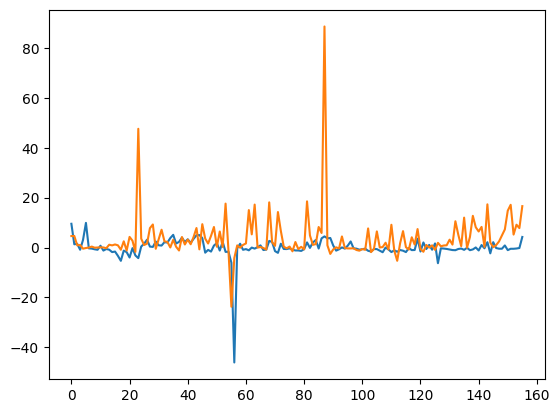

train_weighted_vae: dec
train: iter 0  trainloss -0.37834  validloss 24.95303±0.00000  bestvalidloss 24.95303  last_update 0
train: iter 1  trainloss -0.97059  validloss 12.71793±0.00000  bestvalidloss 12.71793  last_update 0
train: iter 2  trainloss -0.55655  validloss 6.74079±0.00000  bestvalidloss 6.74079  last_update 0
train: iter 3  trainloss 0.58244  validloss 20.19709±0.00000  bestvalidloss 6.74079  last_update 1
train: iter 4  trainloss 0.30788  validloss 13.03338±0.00000  bestvalidloss 6.74079  last_update 2
train: iter 5  trainloss -0.23298  validloss 6.94956±0.00000  bestvalidloss 6.74079  last_update 3
train: iter 6  trainloss -1.72831  validloss 9.79711±0.00000  bestvalidloss 6.74079  last_update 4
train: iter 7  trainloss -0.72087  validloss 6.10212±0.00000  bestvalidloss 6.10212  last_update 0
train: iter 8  trainloss -0.04283  validloss 6.26955±0.00000  bestvalidloss 6.10212  last_update 1
train: iter 9  trainloss -0.87319  validloss 8.15082±0.00000  bestvalidloss 6.102

train: iter 84  trainloss -0.88178  validloss 15.92788±0.00000  bestvalidloss 1.38462  last_update 64
train: iter 85  trainloss -0.91689  validloss 11.34194±0.00000  bestvalidloss 1.38462  last_update 65
train: iter 86  trainloss -0.91425  validloss 17.02484±0.00000  bestvalidloss 1.38462  last_update 66
train: iter 87  trainloss -1.08253  validloss 15.89653±0.00000  bestvalidloss 1.38462  last_update 67
train: iter 88  trainloss -1.28330  validloss 14.84276±0.00000  bestvalidloss 1.38462  last_update 68
train: iter 89  trainloss -1.00282  validloss 20.36998±0.00000  bestvalidloss 1.38462  last_update 69
train: iter 90  trainloss -0.84091  validloss 15.30422±0.00000  bestvalidloss 1.38462  last_update 70
train: iter 91  trainloss 0.28035  validloss 5.73368±0.00000  bestvalidloss 1.38462  last_update 71
train: iter 92  trainloss -1.06577  validloss 11.74525±0.00000  bestvalidloss 1.38462  last_update 72
train: iter 93  trainloss -1.40592  validloss 15.23297±0.00000  bestvalidloss 1.3846

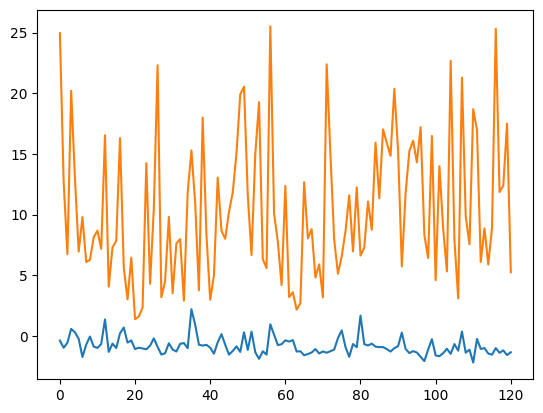

alpha 0.5 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

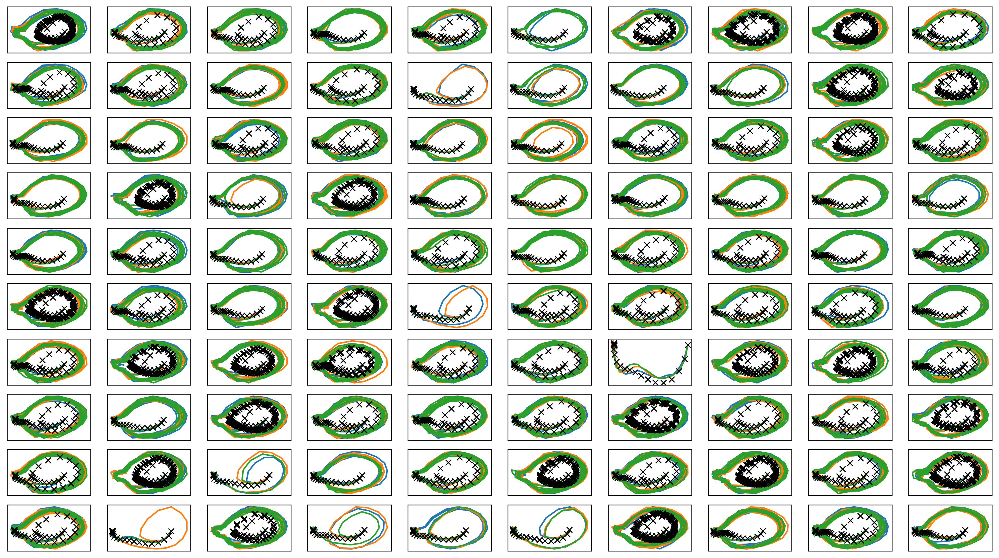

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter2.png")
print("実環境方策rollout vs Sim環境方策rollout")

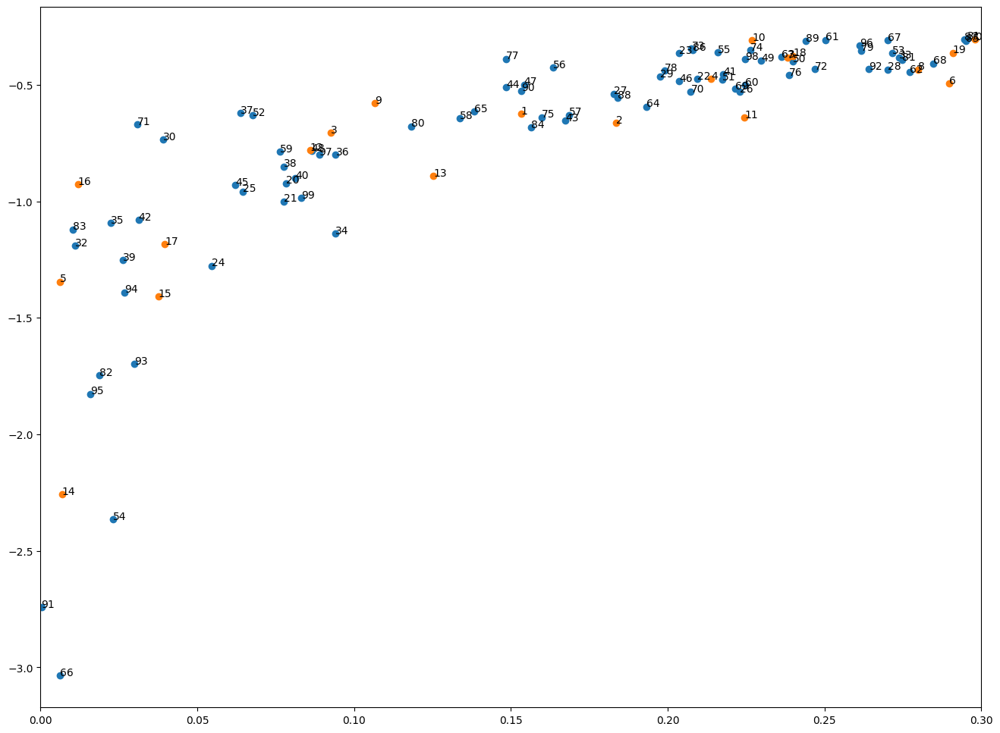

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-03-04 16:08:48.419715


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 6.24243  validloss 14.86394±0.00000  bestvalidloss 14.86394  last_update 0
train: iter 1  trainloss 2.64289  validloss 2.84338±0.00000  bestvalidloss 2.84338  last_update 0
train: iter 2  trainloss 2.24052  validloss 2.20544±0.00000  bestvalidloss 2.20544  last_update 0
train: iter 3  trainloss 2.10726  validloss 2.13729±0.00000  bestvalidloss 2.13729  last_update 0
train: iter 4  trainloss 1.95001  validloss 1.99284±0.00000  bestvalidloss 1.99284  last_update 0
train: iter 5  trainloss 1.90755  validloss 1.88749±0.00000  bestvalidloss 1.88749  last_update 0
train: iter 6  trainloss 1.81463  validloss 1.80611±0.00000  bestvalidloss 1.80611  last_update 0
train: iter 7  trainloss 1.77643  validloss 1.71718±0.00000  bestvalidloss 1.71718  last_update 0
train: iter 8  trainloss 1.70856  validloss 1.60161±0.00000  bestvalidloss 1.60161  last_update 0
train: iter 9  trainloss 1.65566  validloss 1.63773±0.00000  bestvalidloss 1.60161  last_update 1
train: iter 10  tr

train: iter 86  trainloss 0.09785  validloss 0.12238±0.00000  bestvalidloss 0.12238  last_update 0
train: iter 87  trainloss 0.09759  validloss 0.11801±0.00000  bestvalidloss 0.11801  last_update 0
train: iter 88  trainloss 0.09907  validloss 0.12346±0.00000  bestvalidloss 0.11801  last_update 1
train: iter 89  trainloss 0.09591  validloss 0.12027±0.00000  bestvalidloss 0.11801  last_update 2
train: iter 90  trainloss 0.09544  validloss 0.11682±0.00000  bestvalidloss 0.11682  last_update 0
train: iter 91  trainloss 0.09536  validloss 0.11939±0.00000  bestvalidloss 0.11682  last_update 1
train: iter 92  trainloss 0.09445  validloss 0.11625±0.00000  bestvalidloss 0.11625  last_update 0
train: iter 93  trainloss 0.09323  validloss 0.12022±0.00000  bestvalidloss 0.11625  last_update 1
train: iter 94  trainloss 0.09596  validloss 0.11736±0.00000  bestvalidloss 0.11625  last_update 2
train: iter 95  trainloss 0.09219  validloss 0.11651±0.00000  bestvalidloss 0.11625  last_update 3
train: ite

train: iter 168  trainloss 0.07598  validloss 0.09760±0.00000  bestvalidloss 0.09760  last_update 0
train: iter 169  trainloss 0.08139  validloss 0.10899±0.00000  bestvalidloss 0.09760  last_update 1
train: iter 170  trainloss 0.07795  validloss 0.11112±0.00000  bestvalidloss 0.09760  last_update 2
train: iter 171  trainloss 0.07699  validloss 0.10381±0.00000  bestvalidloss 0.09760  last_update 3
train: iter 172  trainloss 0.07933  validloss 0.10246±0.00000  bestvalidloss 0.09760  last_update 4
train: iter 173  trainloss 0.08237  validloss 0.10694±0.00000  bestvalidloss 0.09760  last_update 5
train: iter 174  trainloss 0.07909  validloss 0.10457±0.00000  bestvalidloss 0.09760  last_update 6
train: iter 175  trainloss 0.07764  validloss 0.10404±0.00000  bestvalidloss 0.09760  last_update 7
train: iter 176  trainloss 0.09203  validloss 0.09991±0.00000  bestvalidloss 0.09760  last_update 8
train: iter 177  trainloss 0.08082  validloss 0.10679±0.00000  bestvalidloss 0.09760  last_update 9


train: iter 252  trainloss 0.06864  validloss 0.09914±0.00000  bestvalidloss 0.08769  last_update 17
train: iter 253  trainloss 0.06917  validloss 0.09842±0.00000  bestvalidloss 0.08769  last_update 18
train: iter 254  trainloss 0.06932  validloss 0.09611±0.00000  bestvalidloss 0.08769  last_update 19
train: iter 255  trainloss 0.07251  validloss 0.09312±0.00000  bestvalidloss 0.08769  last_update 20
train: iter 256  trainloss 0.07150  validloss 0.09109±0.00000  bestvalidloss 0.08769  last_update 21
train: iter 257  trainloss 0.07444  validloss 0.09369±0.00000  bestvalidloss 0.08769  last_update 22
train: iter 258  trainloss 0.06948  validloss 0.09172±0.00000  bestvalidloss 0.08769  last_update 23
train: iter 259  trainloss 0.07598  validloss 0.09950±0.00000  bestvalidloss 0.08769  last_update 24
train: iter 260  trainloss 0.06981  validloss 0.09603±0.00000  bestvalidloss 0.08769  last_update 25
train: iter 261  trainloss 0.07047  validloss 0.09978±0.00000  bestvalidloss 0.08769  last_

train: iter 338  trainloss 0.06271  validloss 0.08030±0.00000  bestvalidloss 0.07879  last_update 52
train: iter 339  trainloss 0.06351  validloss 0.09045±0.00000  bestvalidloss 0.07879  last_update 53
train: iter 340  trainloss 0.06381  validloss 0.08392±0.00000  bestvalidloss 0.07879  last_update 54
train: iter 341  trainloss 0.06290  validloss 0.07731±0.00000  bestvalidloss 0.07731  last_update 0
train: iter 342  trainloss 0.06241  validloss 0.09178±0.00000  bestvalidloss 0.07731  last_update 1
train: iter 343  trainloss 0.06711  validloss 0.08868±0.00000  bestvalidloss 0.07731  last_update 2
train: iter 344  trainloss 0.06355  validloss 0.08892±0.00000  bestvalidloss 0.07731  last_update 3
train: iter 345  trainloss 0.06196  validloss 0.08131±0.00000  bestvalidloss 0.07731  last_update 4
train: iter 346  trainloss 0.06210  validloss 0.07980±0.00000  bestvalidloss 0.07731  last_update 5
train: iter 347  trainloss 0.06432  validloss 0.09954±0.00000  bestvalidloss 0.07731  last_update

train: iter 420  trainloss 0.05703  validloss 0.07747±0.00000  bestvalidloss 0.07044  last_update 66
train: iter 421  trainloss 0.05770  validloss 0.08043±0.00000  bestvalidloss 0.07044  last_update 67
train: iter 422  trainloss 0.06500  validloss 0.08727±0.00000  bestvalidloss 0.07044  last_update 68
train: iter 423  trainloss 0.06100  validloss 0.08108±0.00000  bestvalidloss 0.07044  last_update 69
train: iter 424  trainloss 0.06114  validloss 0.07683±0.00000  bestvalidloss 0.07044  last_update 70
train: iter 425  trainloss 0.06077  validloss 0.08117±0.00000  bestvalidloss 0.07044  last_update 71
train: iter 426  trainloss 0.05525  validloss 0.07963±0.00000  bestvalidloss 0.07044  last_update 72
train: iter 427  trainloss 0.06012  validloss 0.07854±0.00000  bestvalidloss 0.07044  last_update 73
train: iter 428  trainloss 0.06241  validloss 0.07436±0.00000  bestvalidloss 0.07044  last_update 74
train: iter 429  trainloss 0.06222  validloss 0.08301±0.00000  bestvalidloss 0.07044  last_

train: iter 504  trainloss 0.05409  validloss 0.07194±0.00000  bestvalidloss 0.06455  last_update 13
train: iter 505  trainloss 0.05382  validloss 0.07001±0.00000  bestvalidloss 0.06455  last_update 14
train: iter 506  trainloss 0.05503  validloss 0.07998±0.00000  bestvalidloss 0.06455  last_update 15
train: iter 507  trainloss 0.05429  validloss 0.07081±0.00000  bestvalidloss 0.06455  last_update 16
train: iter 508  trainloss 0.05888  validloss 0.08185±0.00000  bestvalidloss 0.06455  last_update 17
train: iter 509  trainloss 0.06898  validloss 0.07263±0.00000  bestvalidloss 0.06455  last_update 18
train: iter 510  trainloss 0.05718  validloss 0.09943±0.00000  bestvalidloss 0.06455  last_update 19
train: iter 511  trainloss 0.05298  validloss 0.06827±0.00000  bestvalidloss 0.06455  last_update 20
train: iter 512  trainloss 0.05221  validloss 0.06864±0.00000  bestvalidloss 0.06455  last_update 21
train: iter 513  trainloss 0.04854  validloss 0.07163±0.00000  bestvalidloss 0.06455  last_

train: iter 588  trainloss 0.05198  validloss 0.08547±0.00000  bestvalidloss 0.06148  last_update 31
train: iter 589  trainloss 0.05012  validloss 0.06272±0.00000  bestvalidloss 0.06148  last_update 32
train: iter 590  trainloss 0.04851  validloss 0.06535±0.00000  bestvalidloss 0.06148  last_update 33
train: iter 591  trainloss 0.05282  validloss 0.06817±0.00000  bestvalidloss 0.06148  last_update 34
train: iter 592  trainloss 0.05539  validloss 0.07559±0.00000  bestvalidloss 0.06148  last_update 35
train: iter 593  trainloss 0.05007  validloss 0.08735±0.00000  bestvalidloss 0.06148  last_update 36
train: iter 594  trainloss 0.05389  validloss 0.06720±0.00000  bestvalidloss 0.06148  last_update 37
train: iter 595  trainloss 0.04929  validloss 0.08291±0.00000  bestvalidloss 0.06148  last_update 38
train: iter 596  trainloss 0.04675  validloss 0.06563±0.00000  bestvalidloss 0.06148  last_update 39
train: iter 597  trainloss 0.05283  validloss 0.07471±0.00000  bestvalidloss 0.06148  last_

train: iter 673  trainloss 0.05001  validloss 0.06821±0.00000  bestvalidloss 0.05967  last_update 8
train: iter 674  trainloss 0.04358  validloss 0.06710±0.00000  bestvalidloss 0.05967  last_update 9
train: iter 675  trainloss 0.04860  validloss 0.07156±0.00000  bestvalidloss 0.05967  last_update 10
train: iter 676  trainloss 0.04951  validloss 0.06815±0.00000  bestvalidloss 0.05967  last_update 11
train: iter 677  trainloss 0.04730  validloss 0.07409±0.00000  bestvalidloss 0.05967  last_update 12
train: iter 678  trainloss 0.05020  validloss 0.07108±0.00000  bestvalidloss 0.05967  last_update 13
train: iter 679  trainloss 0.04805  validloss 0.06610±0.00000  bestvalidloss 0.05967  last_update 14
train: iter 680  trainloss 0.04950  validloss 0.06284±0.00000  bestvalidloss 0.05967  last_update 15
train: iter 681  trainloss 0.04621  validloss 0.07052±0.00000  bestvalidloss 0.05967  last_update 16
train: iter 682  trainloss 0.04970  validloss 0.06206±0.00000  bestvalidloss 0.05967  last_up

train: iter 756  trainloss 0.04791  validloss 0.06760±0.00000  bestvalidloss 0.05656  last_update 71
train: iter 757  trainloss 0.04744  validloss 0.06178±0.00000  bestvalidloss 0.05656  last_update 72
train: iter 758  trainloss 0.04643  validloss 0.06457±0.00000  bestvalidloss 0.05656  last_update 73
train: iter 759  trainloss 0.05946  validloss 0.07053±0.00000  bestvalidloss 0.05656  last_update 74
train: iter 760  trainloss 0.04740  validloss 0.06485±0.00000  bestvalidloss 0.05656  last_update 75
train: iter 761  trainloss 0.04715  validloss 0.07350±0.00000  bestvalidloss 0.05656  last_update 76
train: iter 762  trainloss 0.04569  validloss 0.05945±0.00000  bestvalidloss 0.05656  last_update 77
train: iter 763  trainloss 0.04435  validloss 0.06301±0.00000  bestvalidloss 0.05656  last_update 78
train: iter 764  trainloss 0.04278  validloss 0.06030±0.00000  bestvalidloss 0.05656  last_update 79
train: iter 765  trainloss 0.04822  validloss 0.05876±0.00000  bestvalidloss 0.05656  last_

train: iter 839  trainloss 0.04732  validloss 0.06862±0.00000  bestvalidloss 0.04871  last_update 7
train: iter 840  trainloss 0.05105  validloss 0.07117±0.00000  bestvalidloss 0.04871  last_update 8
train: iter 841  trainloss 0.04603  validloss 0.06681±0.00000  bestvalidloss 0.04871  last_update 9
train: iter 842  trainloss 0.04470  validloss 0.06490±0.00000  bestvalidloss 0.04871  last_update 10
train: iter 843  trainloss 0.04690  validloss 0.06298±0.00000  bestvalidloss 0.04871  last_update 11
train: iter 844  trainloss 0.04188  validloss 0.06401±0.00000  bestvalidloss 0.04871  last_update 12
train: iter 845  trainloss 0.04434  validloss 0.07143±0.00000  bestvalidloss 0.04871  last_update 13
train: iter 846  trainloss 0.04285  validloss 0.05682±0.00000  bestvalidloss 0.04871  last_update 14
train: iter 847  trainloss 0.04255  validloss 0.06742±0.00000  bestvalidloss 0.04871  last_update 15
train: iter 848  trainloss 0.04660  validloss 0.05564±0.00000  bestvalidloss 0.04871  last_upd

train: iter 923  trainloss 0.04263  validloss 0.08031±0.00000  bestvalidloss 0.04068  last_update 58
train: iter 924  trainloss 0.04376  validloss 0.05922±0.00000  bestvalidloss 0.04068  last_update 59
train: iter 925  trainloss 0.04817  validloss 0.07186±0.00000  bestvalidloss 0.04068  last_update 60
train: iter 926  trainloss 0.05476  validloss 0.06977±0.00000  bestvalidloss 0.04068  last_update 61
train: iter 927  trainloss 0.04168  validloss 0.05609±0.00000  bestvalidloss 0.04068  last_update 62
train: iter 928  trainloss 0.04234  validloss 0.05986±0.00000  bestvalidloss 0.04068  last_update 63
train: iter 929  trainloss 0.04222  validloss 0.05997±0.00000  bestvalidloss 0.04068  last_update 64
train: iter 930  trainloss 0.04473  validloss 0.07235±0.00000  bestvalidloss 0.04068  last_update 65
train: iter 931  trainloss 0.04238  validloss 0.07108±0.00000  bestvalidloss 0.04068  last_update 66
train: iter 932  trainloss 0.04210  validloss 0.05549±0.00000  bestvalidloss 0.04068  last_

In [33]:
iwvi.eval_loss(weight_alpha=alpha)

train_loss:  -18.152722178893164
valid_loss:  41.32912574458867


1e-08 1000.0


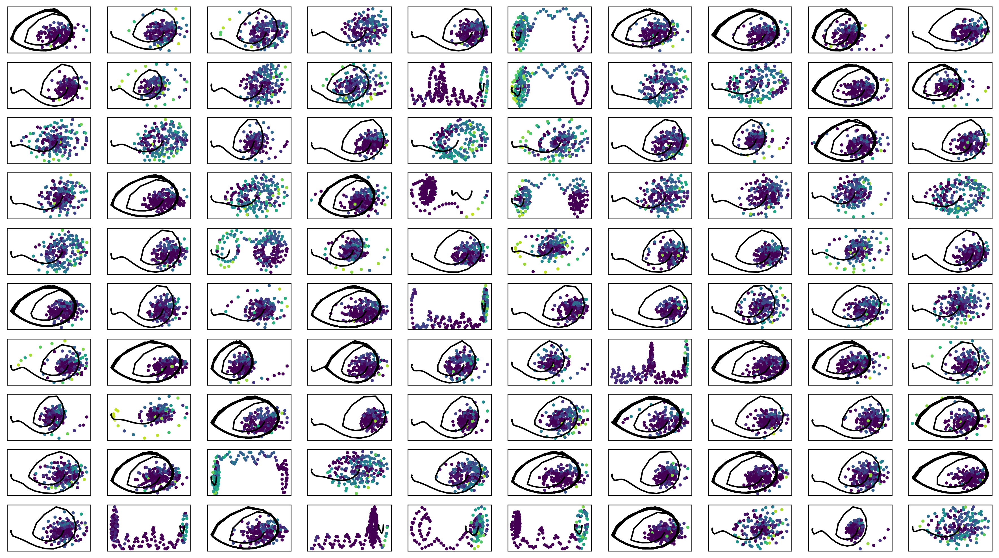

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -2.36464  validloss 15.76694±0.00000  bestvalidloss 15.76694  last_update 0
train: iter 1  trainloss -8.77098  validloss 1.46750±0.00000  bestvalidloss 1.46750  last_update 0
train: iter 2  trainloss -16.55804  validloss -14.80551±0.00000  bestvalidloss -14.80551  last_update 0
train: iter 3  trainloss -19.65940  validloss -20.45807±0.00000  bestvalidloss -20.45807  last_update 0
train: iter 4  trainloss -31.26118  validloss -24.72823±0.00000  bestvalidloss -24.72823  last_update 0
train: iter 5  trainloss -40.32216  validloss -50.48142±0.00000  bestvalidloss -50.48142  last_update 0
train: iter 6  trainloss -29.82537  validloss -56.62012±0.00000  bestvalidloss -56.62012  last_update 0
train: iter 7  trainloss -17.94498  validloss -24.62829±0.00000  bestvalidloss -56.62012  last_update 1
train: iter 8  trainloss -20.43809  validloss -34.04926±0.00000  bestvalidloss -56.62012  last_update 2
train: iter 9  trainloss -25.71016  validlos

train: iter 76  trainloss -122.89244  validloss -154.02987±0.00000  bestvalidloss -187.05983  last_update 51
train: iter 77  trainloss -110.18366  validloss -140.71534±0.00000  bestvalidloss -187.05983  last_update 52
train: iter 78  trainloss -72.36247  validloss -54.14280±0.00000  bestvalidloss -187.05983  last_update 53
train: iter 79  trainloss -98.00847  validloss -117.04568±0.00000  bestvalidloss -187.05983  last_update 54
train: iter 80  trainloss -96.18523  validloss -118.55164±0.00000  bestvalidloss -187.05983  last_update 55
train: iter 81  trainloss -99.18550  validloss -122.67067±0.00000  bestvalidloss -187.05983  last_update 56
train: iter 82  trainloss -102.56665  validloss -128.03617±0.00000  bestvalidloss -187.05983  last_update 57
train: iter 83  trainloss -103.82291  validloss -124.56225±0.00000  bestvalidloss -187.05983  last_update 58
train: iter 84  trainloss -110.42077  validloss -109.10097±0.00000  bestvalidloss -187.05983  last_update 59
train: iter 85  trainlos

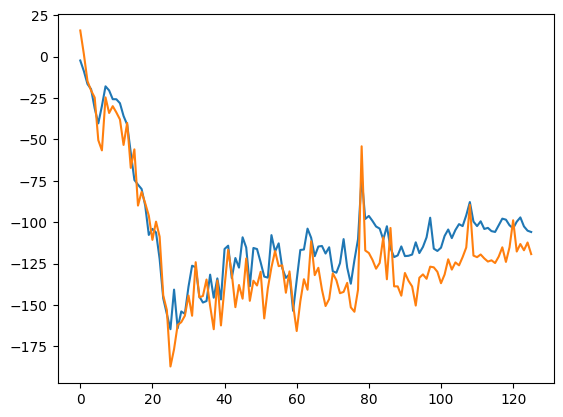

train_weighted_vae: enc
train: iter 0  trainloss -105.37384  validloss -119.99050±0.00000  bestvalidloss -119.99050  last_update 0
train: iter 1  trainloss -108.76612  validloss -126.02239±0.00000  bestvalidloss -126.02239  last_update 0
train: iter 2  trainloss -107.87769  validloss -126.73200±0.00000  bestvalidloss -126.73200  last_update 0
train: iter 3  trainloss -105.08188  validloss -120.32401±0.00000  bestvalidloss -126.73200  last_update 1
train: iter 4  trainloss -105.79119  validloss -123.43206±0.00000  bestvalidloss -126.73200  last_update 2
train: iter 5  trainloss -108.10227  validloss -126.58275±0.00000  bestvalidloss -126.73200  last_update 3
train: iter 6  trainloss -106.10861  validloss -121.19309±0.00000  bestvalidloss -126.73200  last_update 4
train: iter 7  trainloss -105.66103  validloss -122.92243±0.00000  bestvalidloss -126.73200  last_update 5
train: iter 8  trainloss -104.60120  validloss -122.05573±0.00000  bestvalidloss -126.73200  last_update 6
train: iter 9

train: iter 77  trainloss -107.36709  validloss -126.17438±0.00000  bestvalidloss -131.19301  last_update 3
train: iter 78  trainloss -108.37685  validloss -125.75197±0.00000  bestvalidloss -131.19301  last_update 4
train: iter 79  trainloss -107.55720  validloss -126.06547±0.00000  bestvalidloss -131.19301  last_update 5
train: iter 80  trainloss -107.83397  validloss -127.25584±0.00000  bestvalidloss -131.19301  last_update 6
train: iter 81  trainloss -108.97640  validloss -125.66727±0.00000  bestvalidloss -131.19301  last_update 7
train: iter 82  trainloss -105.35733  validloss -122.21246±0.00000  bestvalidloss -131.19301  last_update 8
train: iter 83  trainloss -107.53715  validloss -124.53179±0.00000  bestvalidloss -131.19301  last_update 9
train: iter 84  trainloss -107.51668  validloss -125.12013±0.00000  bestvalidloss -131.19301  last_update 10
train: iter 85  trainloss -109.36412  validloss -127.16184±0.00000  bestvalidloss -131.19301  last_update 11
train: iter 86  trainloss 

train: iter 153  trainloss -106.29040  validloss -125.30245±0.00000  bestvalidloss -131.19301  last_update 79
train: iter 154  trainloss -108.42381  validloss -127.59753±0.00000  bestvalidloss -131.19301  last_update 80
train: iter 155  trainloss -107.27991  validloss -125.16671±0.00000  bestvalidloss -131.19301  last_update 81
train: iter 156  trainloss -106.67125  validloss -125.64235±0.00000  bestvalidloss -131.19301  last_update 82
train: iter 157  trainloss -106.88177  validloss -121.73777±0.00000  bestvalidloss -131.19301  last_update 83
train: iter 158  trainloss -106.81402  validloss -124.08654±0.00000  bestvalidloss -131.19301  last_update 84
train: iter 159  trainloss -109.92780  validloss -116.66987±0.00000  bestvalidloss -131.19301  last_update 85
train: iter 160  trainloss -107.92890  validloss -125.30917±0.00000  bestvalidloss -131.19301  last_update 86
train: iter 161  trainloss -110.09715  validloss -128.50105±0.00000  bestvalidloss -131.19301  last_update 87
train: ite

train: iter 228  trainloss -110.65923  validloss -127.36777±0.00000  bestvalidloss -131.24157  last_update 62
train: iter 229  trainloss -109.41553  validloss -125.36043±0.00000  bestvalidloss -131.24157  last_update 63
train: iter 230  trainloss -107.63209  validloss -128.91255±0.00000  bestvalidloss -131.24157  last_update 64
train: iter 231  trainloss -109.94453  validloss -125.58606±0.00000  bestvalidloss -131.24157  last_update 65
train: iter 232  trainloss -111.17045  validloss -126.73984±0.00000  bestvalidloss -131.24157  last_update 66
train: iter 233  trainloss -110.15449  validloss -126.63142±0.00000  bestvalidloss -131.24157  last_update 67
train: iter 234  trainloss -109.20062  validloss -125.24439±0.00000  bestvalidloss -131.24157  last_update 68
train: iter 235  trainloss -110.23109  validloss -121.98889±0.00000  bestvalidloss -131.24157  last_update 69
train: iter 236  trainloss -110.04402  validloss -127.30447±0.00000  bestvalidloss -131.24157  last_update 70
train: ite

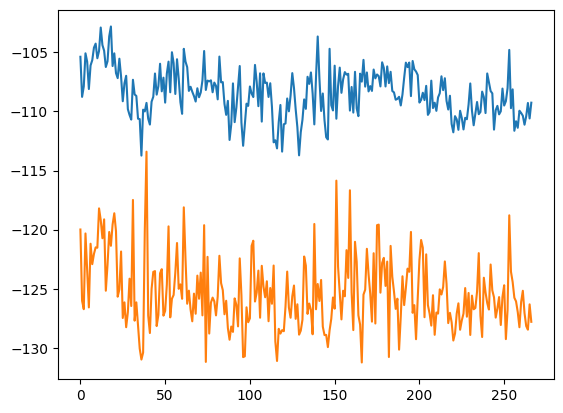

train_weighted_vae: dec
train: iter 0  trainloss -110.09381  validloss -123.80573±0.00000  bestvalidloss -123.80573  last_update 0
train: iter 1  trainloss -109.37350  validloss -128.07386±0.00000  bestvalidloss -128.07386  last_update 0
train: iter 2  trainloss -107.09130  validloss -127.53130±0.00000  bestvalidloss -128.07386  last_update 1
train: iter 3  trainloss -110.20184  validloss -123.49457±0.00000  bestvalidloss -128.07386  last_update 2
train: iter 4  trainloss -109.71397  validloss -128.20316±0.00000  bestvalidloss -128.20316  last_update 0
train: iter 5  trainloss -110.08035  validloss -127.24972±0.00000  bestvalidloss -128.20316  last_update 1
train: iter 6  trainloss -103.34086  validloss -122.69567±0.00000  bestvalidloss -128.20316  last_update 2
train: iter 7  trainloss -106.75751  validloss -114.97764±0.00000  bestvalidloss -128.20316  last_update 3
train: iter 8  trainloss -109.17622  validloss -128.41982±0.00000  bestvalidloss -128.41982  last_update 0
train: iter 9

train: iter 76  trainloss -110.08113  validloss -128.61893±0.00000  bestvalidloss -133.69167  last_update 26
train: iter 77  trainloss -105.89009  validloss -125.34600±0.00000  bestvalidloss -133.69167  last_update 27
train: iter 78  trainloss -110.90717  validloss -128.32432±0.00000  bestvalidloss -133.69167  last_update 28
train: iter 79  trainloss -115.51026  validloss -107.53373±0.00000  bestvalidloss -133.69167  last_update 29
train: iter 80  trainloss -115.50312  validloss -129.79078±0.00000  bestvalidloss -133.69167  last_update 30
train: iter 81  trainloss -114.69555  validloss -129.82147±0.00000  bestvalidloss -133.69167  last_update 31
train: iter 82  trainloss -115.74876  validloss -129.90786±0.00000  bestvalidloss -133.69167  last_update 32
train: iter 83  trainloss -114.71386  validloss -124.51192±0.00000  bestvalidloss -133.69167  last_update 33
train: iter 84  trainloss -115.29662  validloss -129.56245±0.00000  bestvalidloss -133.69167  last_update 34
train: iter 85  tra

train: iter 151  trainloss -117.58085  validloss -122.64893±0.00000  bestvalidloss -134.11381  last_update 18
train: iter 152  trainloss -118.94047  validloss -131.72495±0.00000  bestvalidloss -134.11381  last_update 19
train: iter 153  trainloss -117.33525  validloss -129.68232±0.00000  bestvalidloss -134.11381  last_update 20
train: iter 154  trainloss -98.30963  validloss -130.48194±0.00000  bestvalidloss -134.11381  last_update 21
train: iter 155  trainloss -110.86802  validloss -105.27627±0.00000  bestvalidloss -134.11381  last_update 22
train: iter 156  trainloss -112.25301  validloss -131.51629±0.00000  bestvalidloss -134.11381  last_update 23
train: iter 157  trainloss -114.62177  validloss -132.63497±0.00000  bestvalidloss -134.11381  last_update 24
train: iter 158  trainloss -116.22057  validloss -130.60982±0.00000  bestvalidloss -134.11381  last_update 25
train: iter 159  trainloss -113.79339  validloss -131.85460±0.00000  bestvalidloss -134.11381  last_update 26
train: iter

train: iter 227  trainloss -118.47498  validloss -131.71313±0.00000  bestvalidloss -134.11381  last_update 94
train: iter 228  trainloss -117.73931  validloss -133.70106±0.00000  bestvalidloss -134.11381  last_update 95
train: iter 229  trainloss -115.82317  validloss -131.04566±0.00000  bestvalidloss -134.11381  last_update 96
train: iter 230  trainloss -119.13645  validloss -136.44875±0.00000  bestvalidloss -136.44875  last_update 0
train: iter 231  trainloss -118.39976  validloss -129.79701±0.00000  bestvalidloss -136.44875  last_update 1
train: iter 232  trainloss -116.41100  validloss -120.68828±0.00000  bestvalidloss -136.44875  last_update 2
train: iter 233  trainloss -120.69049  validloss -126.00274±0.00000  bestvalidloss -136.44875  last_update 3
train: iter 234  trainloss -116.22017  validloss -122.36547±0.00000  bestvalidloss -136.44875  last_update 4
train: iter 235  trainloss -114.91250  validloss -122.15536±0.00000  bestvalidloss -136.44875  last_update 5
train: iter 236 

train: iter 302  trainloss -119.46148  validloss -129.61543±0.00000  bestvalidloss -137.62556  last_update 56
train: iter 303  trainloss -113.87048  validloss -130.19541±0.00000  bestvalidloss -137.62556  last_update 57
train: iter 304  trainloss -115.40028  validloss -116.87063±0.00000  bestvalidloss -137.62556  last_update 58
train: iter 305  trainloss -118.94062  validloss -134.06313±0.00000  bestvalidloss -137.62556  last_update 59
train: iter 306  trainloss -116.27129  validloss -131.06643±0.00000  bestvalidloss -137.62556  last_update 60
train: iter 307  trainloss -118.58916  validloss -126.45529±0.00000  bestvalidloss -137.62556  last_update 61
train: iter 308  trainloss -116.89223  validloss -121.68908±0.00000  bestvalidloss -137.62556  last_update 62
train: iter 309  trainloss -115.42315  validloss -129.40904±0.00000  bestvalidloss -137.62556  last_update 63
train: iter 310  trainloss -116.84248  validloss -130.15528±0.00000  bestvalidloss -137.62556  last_update 64
train: ite

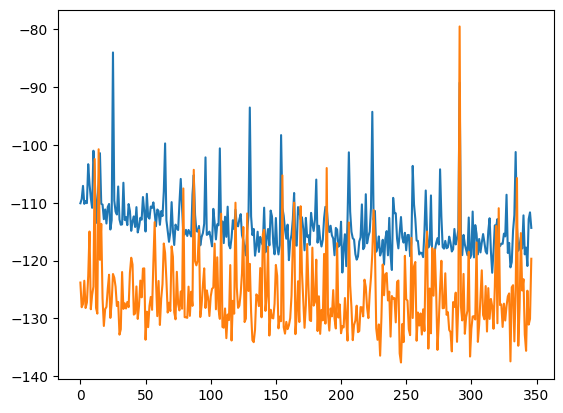

alpha 0.5 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

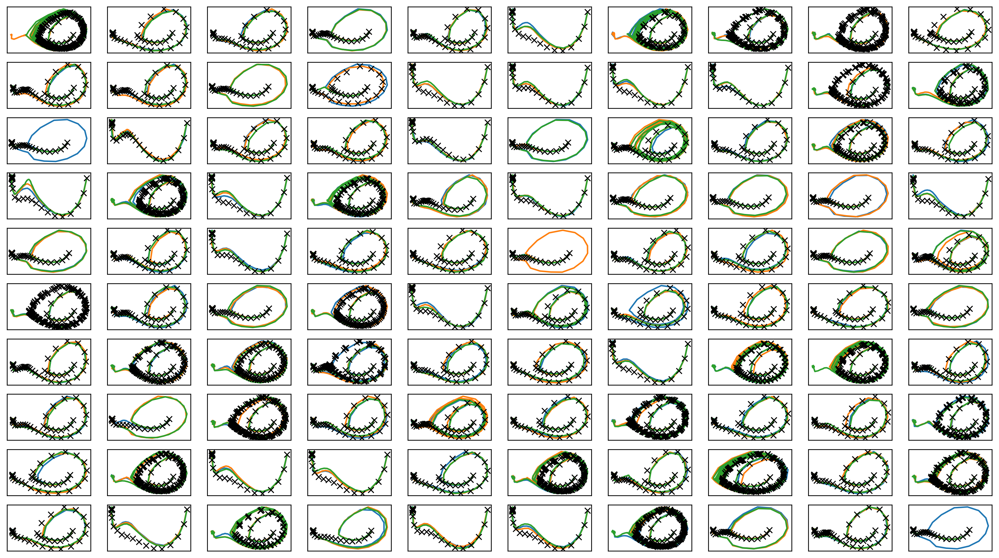

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter3.png")
print("実環境方策rollout vs Sim環境方策rollout")

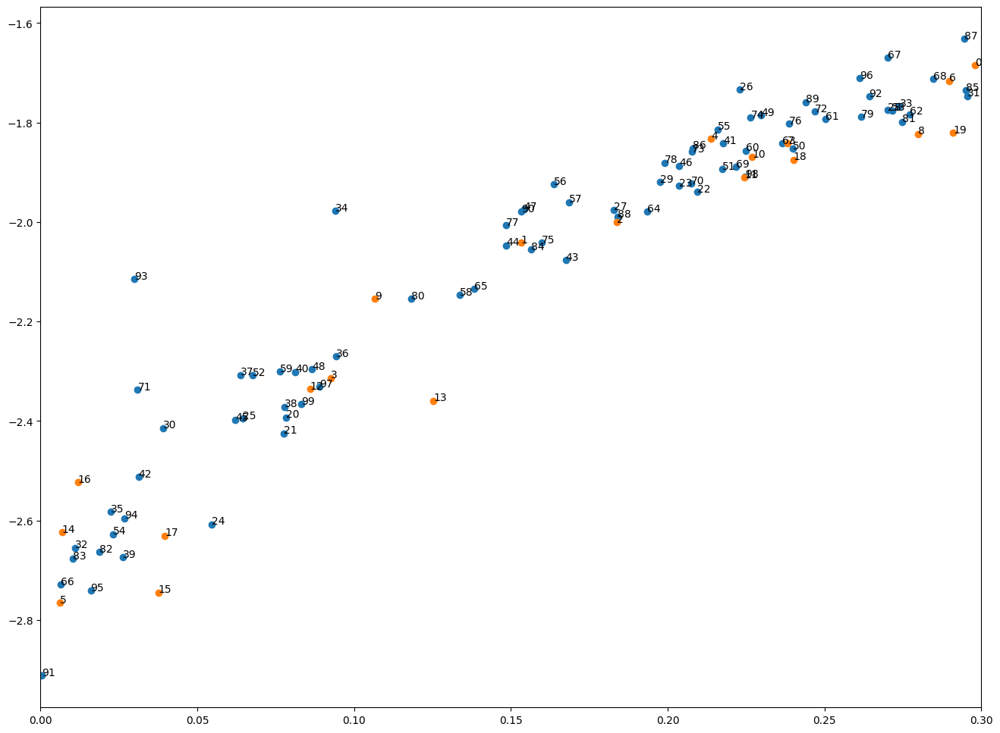

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-03-04 16:14:21.371269


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.27331  validloss 1.24622±0.00000  bestvalidloss 1.24622  last_update 0
train: iter 1  trainloss 0.14822  validloss 0.17455±0.00000  bestvalidloss 0.17455  last_update 0
train: iter 2  trainloss 0.13969  validloss 0.15825±0.00000  bestvalidloss 0.15825  last_update 0
train: iter 3  trainloss 0.13726  validloss 0.14977±0.00000  bestvalidloss 0.14977  last_update 0
train: iter 4  trainloss 0.13005  validloss 0.16593±0.00000  bestvalidloss 0.14977  last_update 1
train: iter 5  trainloss 0.12697  validloss 0.13734±0.00000  bestvalidloss 0.13734  last_update 0
train: iter 6  trainloss 0.12412  validloss 0.13604±0.00000  bestvalidloss 0.13604  last_update 0
train: iter 7  trainloss 0.12247  validloss 0.14462±0.00000  bestvalidloss 0.13604  last_update 1
train: iter 8  trainloss 0.11669  validloss 0.13808±0.00000  bestvalidloss 0.13604  last_update 2
train: iter 9  trainloss 0.11110  validloss 0.12892±0.00000  bestvalidloss 0.12892  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.06356  validloss 0.08408±0.00000  bestvalidloss 0.08408  last_update 0
train: iter 85  trainloss 0.06409  validloss 0.08429±0.00000  bestvalidloss 0.08408  last_update 1
train: iter 86  trainloss 0.06492  validloss 0.08669±0.00000  bestvalidloss 0.08408  last_update 2
train: iter 87  trainloss 0.06721  validloss 0.08876±0.00000  bestvalidloss 0.08408  last_update 3
train: iter 88  trainloss 0.07228  validloss 0.09814±0.00000  bestvalidloss 0.08408  last_update 4
train: iter 89  trainloss 0.06335  validloss 0.08752±0.00000  bestvalidloss 0.08408  last_update 5
train: iter 90  trainloss 0.06476  validloss 0.08209±0.00000  bestvalidloss 0.08209  last_update 0
train: iter 91  trainloss 0.06424  validloss 0.08147±0.00000  bestvalidloss 0.08147  last_update 0
train: iter 92  trainloss 0.06657  validloss 0.08048±0.00000  bestvalidloss 0.08048  last_update 0
train: iter 93  trainloss 0.06189  validloss 0.08534±0.00000  bestvalidloss 0.08048  last_update 1
train: ite

train: iter 167  trainloss 0.06101  validloss 0.11089±0.00000  bestvalidloss 0.07119  last_update 4
train: iter 168  trainloss 0.05416  validloss 0.07100±0.00000  bestvalidloss 0.07100  last_update 0
train: iter 169  trainloss 0.05951  validloss 0.07345±0.00000  bestvalidloss 0.07100  last_update 1
train: iter 170  trainloss 0.05446  validloss 0.07370±0.00000  bestvalidloss 0.07100  last_update 2
train: iter 171  trainloss 0.05414  validloss 0.07061±0.00000  bestvalidloss 0.07061  last_update 0
train: iter 172  trainloss 0.05534  validloss 0.07719±0.00000  bestvalidloss 0.07061  last_update 1
train: iter 173  trainloss 0.05682  validloss 0.07671±0.00000  bestvalidloss 0.07061  last_update 2
train: iter 174  trainloss 0.05750  validloss 0.08754±0.00000  bestvalidloss 0.07061  last_update 3
train: iter 175  trainloss 0.06442  validloss 0.08228±0.00000  bestvalidloss 0.07061  last_update 4
train: iter 176  trainloss 0.05557  validloss 0.07055±0.00000  bestvalidloss 0.07055  last_update 0


train: iter 251  trainloss 0.05096  validloss 0.06512±0.00000  bestvalidloss 0.06235  last_update 13
train: iter 252  trainloss 0.05065  validloss 0.06485±0.00000  bestvalidloss 0.06235  last_update 14
train: iter 253  trainloss 0.05472  validloss 0.06551±0.00000  bestvalidloss 0.06235  last_update 15
train: iter 254  trainloss 0.05827  validloss 0.09451±0.00000  bestvalidloss 0.06235  last_update 16
train: iter 255  trainloss 0.05061  validloss 0.06282±0.00000  bestvalidloss 0.06235  last_update 17
train: iter 256  trainloss 0.05071  validloss 0.06491±0.00000  bestvalidloss 0.06235  last_update 18
train: iter 257  trainloss 0.05087  validloss 0.07804±0.00000  bestvalidloss 0.06235  last_update 19
train: iter 258  trainloss 0.05093  validloss 0.06407±0.00000  bestvalidloss 0.06235  last_update 20
train: iter 259  trainloss 0.05045  validloss 0.06664±0.00000  bestvalidloss 0.06235  last_update 21
train: iter 260  trainloss 0.05485  validloss 0.06260±0.00000  bestvalidloss 0.06235  last_

train: iter 336  trainloss 0.04808  validloss 0.06118±0.00000  bestvalidloss 0.05809  last_update 1
train: iter 337  trainloss 0.05257  validloss 0.05833±0.00000  bestvalidloss 0.05809  last_update 2
train: iter 338  trainloss 0.05142  validloss 0.06203±0.00000  bestvalidloss 0.05809  last_update 3
train: iter 339  trainloss 0.04771  validloss 0.06208±0.00000  bestvalidloss 0.05809  last_update 4
train: iter 340  trainloss 0.04595  validloss 0.06253±0.00000  bestvalidloss 0.05809  last_update 5
train: iter 341  trainloss 0.05149  validloss 0.05872±0.00000  bestvalidloss 0.05809  last_update 6
train: iter 342  trainloss 0.04763  validloss 0.06490±0.00000  bestvalidloss 0.05809  last_update 7
train: iter 343  trainloss 0.04747  validloss 0.05772±0.00000  bestvalidloss 0.05772  last_update 0
train: iter 344  trainloss 0.05082  validloss 0.05706±0.00000  bestvalidloss 0.05706  last_update 0
train: iter 345  trainloss 0.05072  validloss 0.06113±0.00000  bestvalidloss 0.05706  last_update 1


train: iter 419  trainloss 0.05182  validloss 0.05694±0.00000  bestvalidloss 0.05435  last_update 47
train: iter 420  trainloss 0.04347  validloss 0.05453±0.00000  bestvalidloss 0.05435  last_update 48
train: iter 421  trainloss 0.04622  validloss 0.06482±0.00000  bestvalidloss 0.05435  last_update 49
train: iter 422  trainloss 0.04474  validloss 0.05313±0.00000  bestvalidloss 0.05313  last_update 0
train: iter 423  trainloss 0.04748  validloss 0.05407±0.00000  bestvalidloss 0.05313  last_update 1
train: iter 424  trainloss 0.05375  validloss 0.08761±0.00000  bestvalidloss 0.05313  last_update 2
train: iter 425  trainloss 0.04794  validloss 0.05881±0.00000  bestvalidloss 0.05313  last_update 3
train: iter 426  trainloss 0.04884  validloss 0.05607±0.00000  bestvalidloss 0.05313  last_update 4
train: iter 427  trainloss 0.04371  validloss 0.05531±0.00000  bestvalidloss 0.05313  last_update 5
train: iter 428  trainloss 0.04538  validloss 0.05847±0.00000  bestvalidloss 0.05313  last_update

train: iter 504  trainloss 0.04295  validloss 0.05228±0.00000  bestvalidloss 0.05190  last_update 4
train: iter 505  trainloss 0.04224  validloss 0.05399±0.00000  bestvalidloss 0.05190  last_update 5
train: iter 506  trainloss 0.04525  validloss 0.05262±0.00000  bestvalidloss 0.05190  last_update 6
train: iter 507  trainloss 0.04277  validloss 0.05655±0.00000  bestvalidloss 0.05190  last_update 7
train: iter 508  trainloss 0.04465  validloss 0.05286±0.00000  bestvalidloss 0.05190  last_update 8
train: iter 509  trainloss 0.04292  validloss 0.05144±0.00000  bestvalidloss 0.05144  last_update 0
train: iter 510  trainloss 0.04314  validloss 0.05502±0.00000  bestvalidloss 0.05144  last_update 1
train: iter 511  trainloss 0.04687  validloss 0.05363±0.00000  bestvalidloss 0.05144  last_update 2
train: iter 512  trainloss 0.04373  validloss 0.05272±0.00000  bestvalidloss 0.05144  last_update 3
train: iter 513  trainloss 0.04201  validloss 0.05582±0.00000  bestvalidloss 0.05144  last_update 4


train: iter 588  trainloss 0.03995  validloss 0.05314±0.00000  bestvalidloss 0.05002  last_update 1
train: iter 589  trainloss 0.04079  validloss 0.05125±0.00000  bestvalidloss 0.05002  last_update 2
train: iter 590  trainloss 0.04556  validloss 0.05145±0.00000  bestvalidloss 0.05002  last_update 3
train: iter 591  trainloss 0.04220  validloss 0.05828±0.00000  bestvalidloss 0.05002  last_update 4
train: iter 592  trainloss 0.04069  validloss 0.05190±0.00000  bestvalidloss 0.05002  last_update 5
train: iter 593  trainloss 0.04149  validloss 0.05417±0.00000  bestvalidloss 0.05002  last_update 6
train: iter 594  trainloss 0.03957  validloss 0.05195±0.00000  bestvalidloss 0.05002  last_update 7
train: iter 595  trainloss 0.04660  validloss 0.05292±0.00000  bestvalidloss 0.05002  last_update 8
train: iter 596  trainloss 0.04401  validloss 0.05353±0.00000  bestvalidloss 0.05002  last_update 9
train: iter 597  trainloss 0.04214  validloss 0.05494±0.00000  bestvalidloss 0.05002  last_update 10

train: iter 673  trainloss 0.04008  validloss 0.05272±0.00000  bestvalidloss 0.05002  last_update 86
train: iter 674  trainloss 0.04500  validloss 0.05057±0.00000  bestvalidloss 0.05002  last_update 87
train: iter 675  trainloss 0.03998  validloss 0.04979±0.00000  bestvalidloss 0.04979  last_update 0
train: iter 676  trainloss 0.03965  validloss 0.05140±0.00000  bestvalidloss 0.04979  last_update 1
train: iter 677  trainloss 0.03877  validloss 0.05093±0.00000  bestvalidloss 0.04979  last_update 2
train: iter 678  trainloss 0.04051  validloss 0.05594±0.00000  bestvalidloss 0.04979  last_update 3
train: iter 679  trainloss 0.03938  validloss 0.05387±0.00000  bestvalidloss 0.04979  last_update 4
train: iter 680  trainloss 0.04000  validloss 0.06186±0.00000  bestvalidloss 0.04979  last_update 5
train: iter 681  trainloss 0.04245  validloss 0.05329±0.00000  bestvalidloss 0.04979  last_update 6
train: iter 682  trainloss 0.04430  validloss 0.06139±0.00000  bestvalidloss 0.04979  last_update 

train: iter 758  trainloss 0.03783  validloss 0.04972±0.00000  bestvalidloss 0.04868  last_update 26
train: iter 759  trainloss 0.03813  validloss 0.05172±0.00000  bestvalidloss 0.04868  last_update 27
train: iter 760  trainloss 0.03836  validloss 0.05190±0.00000  bestvalidloss 0.04868  last_update 28
train: iter 761  trainloss 0.03855  validloss 0.05062±0.00000  bestvalidloss 0.04868  last_update 29
train: iter 762  trainloss 0.04081  validloss 0.05096±0.00000  bestvalidloss 0.04868  last_update 30
train: iter 763  trainloss 0.03819  validloss 0.05212±0.00000  bestvalidloss 0.04868  last_update 31
train: iter 764  trainloss 0.03846  validloss 0.05071±0.00000  bestvalidloss 0.04868  last_update 32
train: iter 765  trainloss 0.03993  validloss 0.05202±0.00000  bestvalidloss 0.04868  last_update 33
train: iter 766  trainloss 0.04250  validloss 0.05134±0.00000  bestvalidloss 0.04868  last_update 34
train: iter 767  trainloss 0.04013  validloss 0.05366±0.00000  bestvalidloss 0.04868  last_

In [44]:
iwvi.eval_loss(weight_alpha=alpha)

train_loss:  -79.61827282175423
valid_loss:  -197.1102618908882


1e-08 1000.0


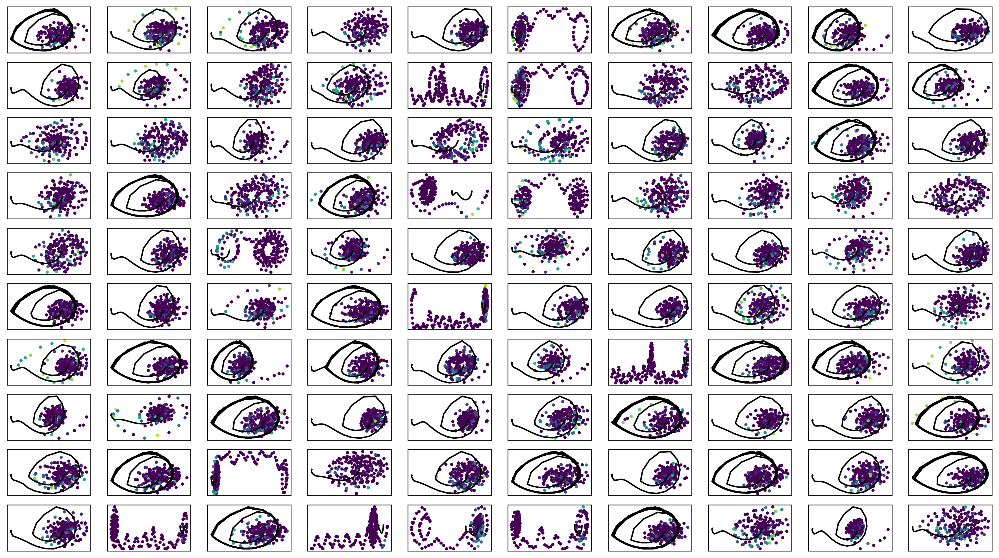

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -22.32589  validloss -32.44611±0.00000  bestvalidloss -32.44611  last_update 0
train: iter 1  trainloss -20.13891  validloss -22.44398±0.00000  bestvalidloss -32.44611  last_update 1
train: iter 2  trainloss -18.07623  validloss -44.98807±0.00000  bestvalidloss -44.98807  last_update 0
train: iter 3  trainloss -21.25579  validloss -41.01160±0.00000  bestvalidloss -44.98807  last_update 1
train: iter 4  trainloss -20.52256  validloss -26.02873±0.00000  bestvalidloss -44.98807  last_update 2
train: iter 5  trainloss -21.88324  validloss -37.09375±0.00000  bestvalidloss -44.98807  last_update 3
train: iter 6  trainloss -21.37093  validloss -40.62103±0.00000  bestvalidloss -44.98807  last_update 4
train: iter 7  trainloss -21.73369  validloss -24.04165±0.00000  bestvalidloss -44.98807  last_update 5
train: iter 8  trainloss -23.22519  validloss -40.34742±0.00000  bestvalidloss -44.98807  last_update 6
train: iter 9  trainloss -26.39912  

train: iter 80  trainloss -56.22603  validloss -70.43417±0.00000  bestvalidloss -73.33952  last_update 3
train: iter 81  trainloss -50.84106  validloss -85.68400±0.00000  bestvalidloss -85.68400  last_update 0
train: iter 82  trainloss -57.20511  validloss -60.94692±0.00000  bestvalidloss -85.68400  last_update 1
train: iter 83  trainloss -57.00229  validloss -45.77645±0.00000  bestvalidloss -85.68400  last_update 2
train: iter 84  trainloss -56.51765  validloss -75.38599±0.00000  bestvalidloss -85.68400  last_update 3
train: iter 85  trainloss -53.04534  validloss -67.04048±0.00000  bestvalidloss -85.68400  last_update 4
train: iter 86  trainloss -51.94634  validloss -58.71558±0.00000  bestvalidloss -85.68400  last_update 5
train: iter 87  trainloss -61.94371  validloss -30.18449±0.00000  bestvalidloss -85.68400  last_update 6
train: iter 88  trainloss -58.84614  validloss -63.84980±0.00000  bestvalidloss -85.68400  last_update 7
train: iter 89  trainloss -51.34161  validloss -54.2142

train: iter 158  trainloss -64.92121  validloss -44.69584±0.00000  bestvalidloss -93.91103  last_update 23
train: iter 159  trainloss -52.98431  validloss -55.43160±0.00000  bestvalidloss -93.91103  last_update 24
train: iter 160  trainloss -55.45711  validloss -52.17772±0.00000  bestvalidloss -93.91103  last_update 25
train: iter 161  trainloss -56.72628  validloss -40.28166±0.00000  bestvalidloss -93.91103  last_update 26
train: iter 162  trainloss -61.43465  validloss -57.37449±0.00000  bestvalidloss -93.91103  last_update 27
train: iter 163  trainloss -60.68060  validloss -55.96616±0.00000  bestvalidloss -93.91103  last_update 28
train: iter 164  trainloss -62.45754  validloss -56.73158±0.00000  bestvalidloss -93.91103  last_update 29
train: iter 165  trainloss -62.49512  validloss -82.62444±0.00000  bestvalidloss -93.91103  last_update 30
train: iter 166  trainloss -59.87483  validloss -68.38215±0.00000  bestvalidloss -93.91103  last_update 31
train: iter 167  trainloss -58.12314 

train: iter 235  trainloss -61.92301  validloss -48.02957±0.00000  bestvalidloss -93.91103  last_update 100
train: fin


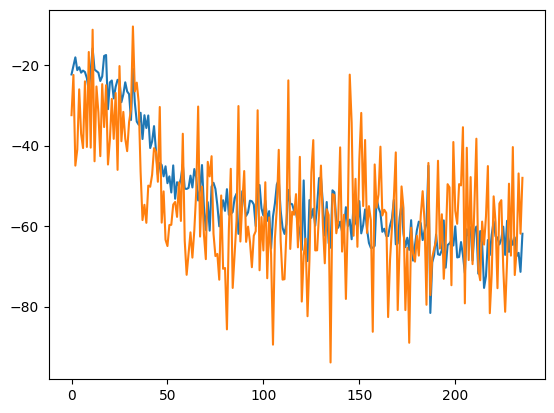

train_weighted_vae: enc
train: iter 0  trainloss -63.49008  validloss -66.57547±0.00000  bestvalidloss -66.57547  last_update 0
train: iter 1  trainloss -66.68452  validloss -63.83743±0.00000  bestvalidloss -66.57547  last_update 1
train: iter 2  trainloss -61.89124  validloss -47.41302±0.00000  bestvalidloss -66.57547  last_update 2
train: iter 3  trainloss -62.14192  validloss -54.88577±0.00000  bestvalidloss -66.57547  last_update 3
train: iter 4  trainloss -61.85709  validloss -49.80034±0.00000  bestvalidloss -66.57547  last_update 4
train: iter 5  trainloss -61.93104  validloss -41.69201±0.00000  bestvalidloss -66.57547  last_update 5
train: iter 6  trainloss -64.54195  validloss -69.49954±0.00000  bestvalidloss -69.49954  last_update 0
train: iter 7  trainloss -68.23039  validloss -74.22774±0.00000  bestvalidloss -74.22774  last_update 0
train: iter 8  trainloss -65.51761  validloss -64.72335±0.00000  bestvalidloss -74.22774  last_update 1
train: iter 9  trainloss -63.73911  vali

train: iter 78  trainloss -62.39835  validloss -48.19903±0.00000  bestvalidloss -75.09321  last_update 56
train: iter 79  trainloss -62.90373  validloss -55.70806±0.00000  bestvalidloss -75.09321  last_update 57
train: iter 80  trainloss -62.56167  validloss -49.78387±0.00000  bestvalidloss -75.09321  last_update 58
train: iter 81  trainloss -63.68874  validloss -70.53597±0.00000  bestvalidloss -75.09321  last_update 59
train: iter 82  trainloss -60.21812  validloss -63.82866±0.00000  bestvalidloss -75.09321  last_update 60
train: iter 83  trainloss -54.91810  validloss -69.54703±0.00000  bestvalidloss -75.09321  last_update 61
train: iter 84  trainloss -59.82958  validloss -46.60032±0.00000  bestvalidloss -75.09321  last_update 62
train: iter 85  trainloss -62.37283  validloss -60.17522±0.00000  bestvalidloss -75.09321  last_update 63
train: iter 86  trainloss -60.50033  validloss -64.30868±0.00000  bestvalidloss -75.09321  last_update 64
train: iter 87  trainloss -58.61752  validloss

train: iter 155  trainloss -61.32992  validloss -57.78948±0.00000  bestvalidloss -88.17096  last_update 54
train: iter 156  trainloss -63.31528  validloss -48.36612±0.00000  bestvalidloss -88.17096  last_update 55
train: iter 157  trainloss -65.77798  validloss -44.41147±0.00000  bestvalidloss -88.17096  last_update 56
train: iter 158  trainloss -62.04139  validloss -61.11930±0.00000  bestvalidloss -88.17096  last_update 57
train: iter 159  trainloss -65.58893  validloss -58.21497±0.00000  bestvalidloss -88.17096  last_update 58
train: iter 160  trainloss -67.73197  validloss -52.03289±0.00000  bestvalidloss -88.17096  last_update 59
train: iter 161  trainloss -63.83236  validloss -53.13687±0.00000  bestvalidloss -88.17096  last_update 60
train: iter 162  trainloss -64.84238  validloss -63.86428±0.00000  bestvalidloss -88.17096  last_update 61
train: iter 163  trainloss -62.88700  validloss -47.87151±0.00000  bestvalidloss -88.17096  last_update 62
train: iter 164  trainloss -67.83837 

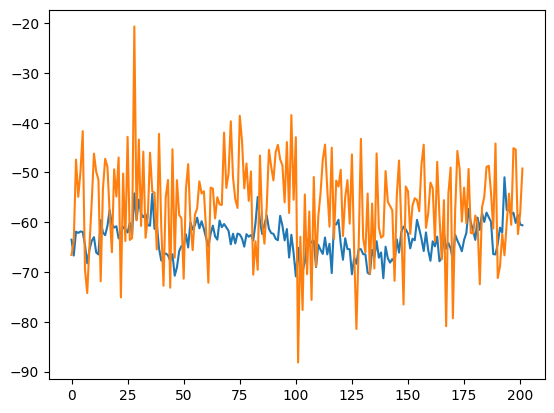

train_weighted_vae: dec
train: iter 0  trainloss -58.18249  validloss -45.53930±0.00000  bestvalidloss -45.53930  last_update 0
train: iter 1  trainloss -59.97260  validloss -54.39165±0.00000  bestvalidloss -54.39165  last_update 0
train: iter 2  trainloss -59.01961  validloss -49.06121±0.00000  bestvalidloss -54.39165  last_update 1
train: iter 3  trainloss -59.43003  validloss -24.79154±0.00000  bestvalidloss -54.39165  last_update 2
train: iter 4  trainloss -57.05910  validloss -44.51193±0.00000  bestvalidloss -54.39165  last_update 3
train: iter 5  trainloss -54.70335  validloss -50.60712±0.00000  bestvalidloss -54.39165  last_update 4
train: iter 6  trainloss -58.79856  validloss -46.00792±0.00000  bestvalidloss -54.39165  last_update 5
train: iter 7  trainloss -60.33393  validloss -42.38828±0.00000  bestvalidloss -54.39165  last_update 6
train: iter 8  trainloss -54.77025  validloss -44.44702±0.00000  bestvalidloss -54.39165  last_update 7
train: iter 9  trainloss -59.32043  vali

train: iter 78  trainloss -59.54131  validloss -19.39164±0.00000  bestvalidloss -54.56862  last_update 68
train: iter 79  trainloss -61.07544  validloss -34.25841±0.00000  bestvalidloss -54.56862  last_update 69
train: iter 80  trainloss -61.03734  validloss -31.47283±0.00000  bestvalidloss -54.56862  last_update 70
train: iter 81  trainloss -58.36429  validloss -37.14094±0.00000  bestvalidloss -54.56862  last_update 71
train: iter 82  trainloss -58.40219  validloss -33.16762±0.00000  bestvalidloss -54.56862  last_update 72
train: iter 83  trainloss -61.07280  validloss -39.92977±0.00000  bestvalidloss -54.56862  last_update 73
train: iter 84  trainloss -56.61800  validloss -38.91994±0.00000  bestvalidloss -54.56862  last_update 74
train: iter 85  trainloss -52.94322  validloss -38.82798±0.00000  bestvalidloss -54.56862  last_update 75
train: iter 86  trainloss -59.11321  validloss -43.68233±0.00000  bestvalidloss -54.56862  last_update 76
train: iter 87  trainloss -61.32993  validloss

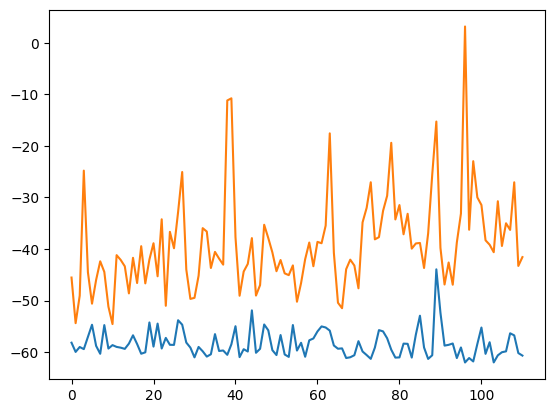

alpha 0.5 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

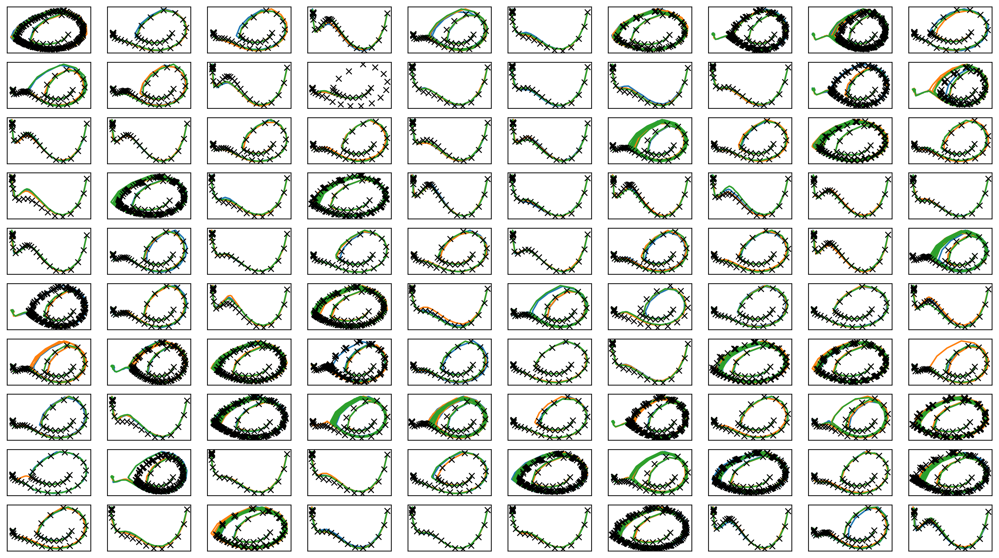

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter4.png")
print("実環境方策rollout vs Sim環境方策rollout")

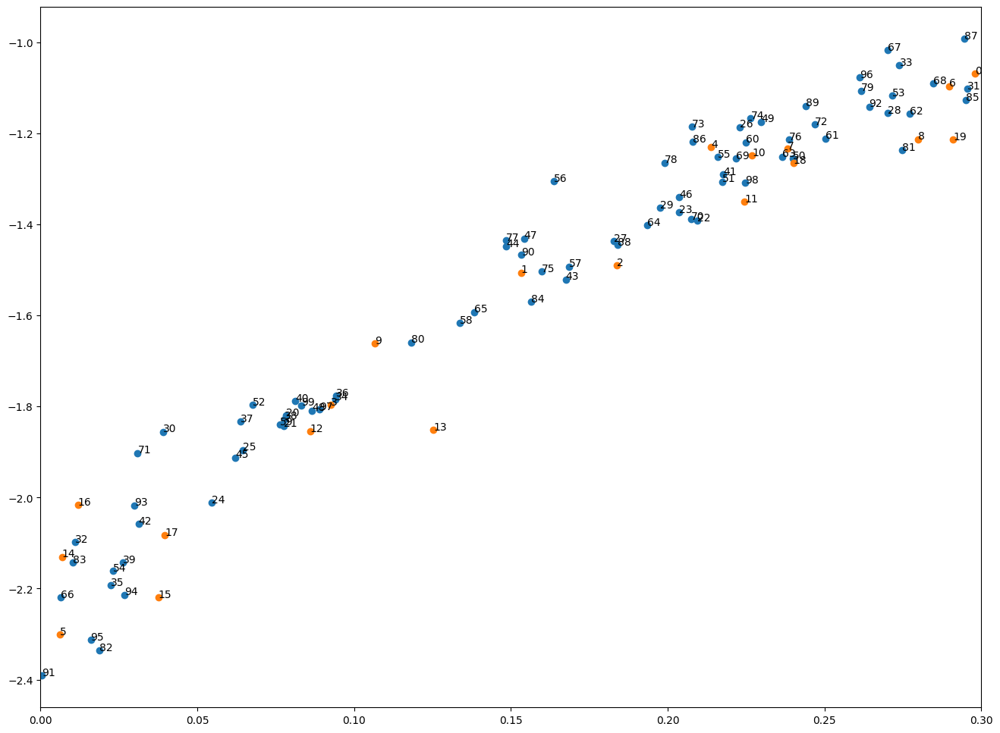

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-03-04 16:17:28.183422


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.16343  validloss 0.45016±0.00000  bestvalidloss 0.45016  last_update 0
train: iter 1  trainloss 0.09818  validloss 0.12002±0.00000  bestvalidloss 0.12002  last_update 0
train: iter 2  trainloss 0.08443  validloss 0.09323±0.00000  bestvalidloss 0.09323  last_update 0
train: iter 3  trainloss 0.06899  validloss 0.09001±0.00000  bestvalidloss 0.09001  last_update 0
train: iter 4  trainloss 0.05976  validloss 0.06747±0.00000  bestvalidloss 0.06747  last_update 0
train: iter 5  trainloss 0.05610  validloss 0.05602±0.00000  bestvalidloss 0.05602  last_update 0
train: iter 6  trainloss 0.06524  validloss 0.05661±0.00000  bestvalidloss 0.05602  last_update 1
train: iter 7  trainloss 0.06158  validloss 0.05420±0.00000  bestvalidloss 0.05420  last_update 0
train: iter 8  trainloss 0.05270  validloss 0.06653±0.00000  bestvalidloss 0.05420  last_update 1
train: iter 9  trainloss 0.04631  validloss 0.05074±0.00000  bestvalidloss 0.05074  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.03674  validloss 0.05000±0.00000  bestvalidloss 0.04672  last_update 55
train: iter 85  trainloss 0.03789  validloss 0.05010±0.00000  bestvalidloss 0.04672  last_update 56
train: iter 86  trainloss 0.04678  validloss 0.05100±0.00000  bestvalidloss 0.04672  last_update 57
train: iter 87  trainloss 0.04133  validloss 0.05154±0.00000  bestvalidloss 0.04672  last_update 58
train: iter 88  trainloss 0.03583  validloss 0.05070±0.00000  bestvalidloss 0.04672  last_update 59
train: iter 89  trainloss 0.03845  validloss 0.05462±0.00000  bestvalidloss 0.04672  last_update 60
train: iter 90  trainloss 0.03685  validloss 0.05307±0.00000  bestvalidloss 0.04672  last_update 61
train: iter 91  trainloss 0.03663  validloss 0.05275±0.00000  bestvalidloss 0.04672  last_update 62
train: iter 92  trainloss 0.03636  validloss 0.05103±0.00000  bestvalidloss 0.04672  last_update 63
train: iter 93  trainloss 0.03953  validloss 0.04921±0.00000  bestvalidloss 0.04672  last_update 64


In [55]:
iwvi.eval_loss(weight_alpha=alpha)

train_loss:  -142.97104266822336
valid_loss:  -130.32062673568726


1e-08 1000.0


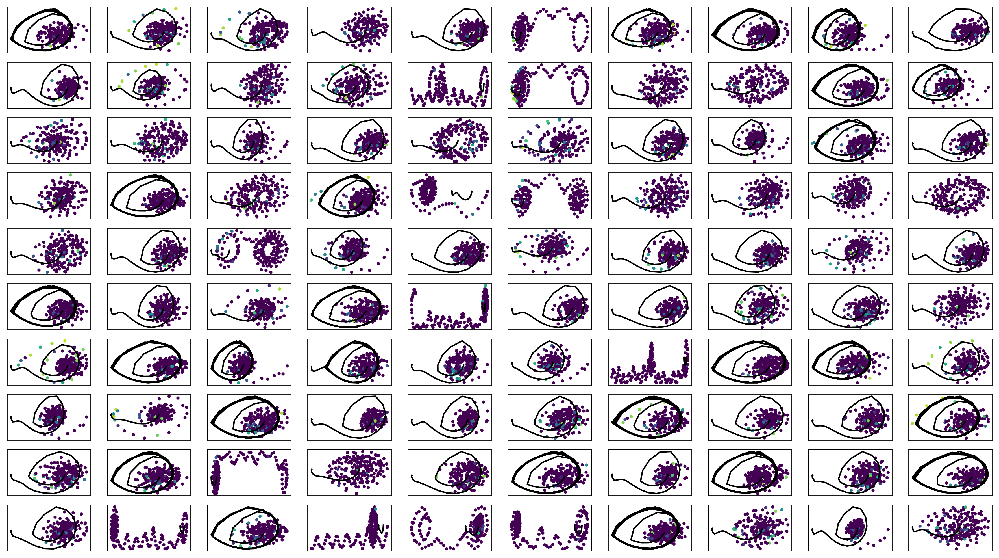

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -26.08561  validloss -25.13781±0.00000  bestvalidloss -25.13781  last_update 0
train: iter 1  trainloss -35.31557  validloss -15.28826±0.00000  bestvalidloss -25.13781  last_update 1
train: iter 2  trainloss -30.77475  validloss -48.75650±0.00000  bestvalidloss -48.75650  last_update 0
train: iter 3  trainloss -29.15535  validloss -40.97294±0.00000  bestvalidloss -48.75650  last_update 1
train: iter 4  trainloss -13.72254  validloss -6.96742±0.00000  bestvalidloss -48.75650  last_update 2
train: iter 5  trainloss -27.48223  validloss -60.62078±0.00000  bestvalidloss -60.62078  last_update 0
train: iter 6  trainloss -31.11336  validloss -47.68866±0.00000  bestvalidloss -60.62078  last_update 1
train: iter 7  trainloss -35.13198  validloss -48.53365±0.00000  bestvalidloss -60.62078  last_update 2
train: iter 8  trainloss -33.29092  validloss -45.34392±0.00000  bestvalidloss -60.62078  last_update 3
train: iter 9  trainloss -33.95789  v

train: iter 78  trainloss -44.26247  validloss -46.00274±0.00000  bestvalidloss -73.80558  last_update 20
train: iter 79  trainloss -44.43667  validloss -54.75441±0.00000  bestvalidloss -73.80558  last_update 21
train: iter 80  trainloss -43.80007  validloss -61.36065±0.00000  bestvalidloss -73.80558  last_update 22
train: iter 81  trainloss -43.64785  validloss -61.91031±0.00000  bestvalidloss -73.80558  last_update 23
train: iter 82  trainloss -28.32474  validloss -50.73940±0.00000  bestvalidloss -73.80558  last_update 24
train: iter 83  trainloss -43.98577  validloss -60.76827±0.00000  bestvalidloss -73.80558  last_update 25
train: iter 84  trainloss -49.48166  validloss -56.77542±0.00000  bestvalidloss -73.80558  last_update 26
train: iter 85  trainloss -49.04388  validloss -68.08151±0.00000  bestvalidloss -73.80558  last_update 27
train: iter 86  trainloss -45.33736  validloss -56.42531±0.00000  bestvalidloss -73.80558  last_update 28
train: iter 87  trainloss -45.12641  validloss

train: iter 155  trainloss -51.13248  validloss -60.58172±0.00000  bestvalidloss -89.61460  last_update 20
train: iter 156  trainloss -31.92691  validloss -62.03685±0.00000  bestvalidloss -89.61460  last_update 21
train: iter 157  trainloss -42.62908  validloss -58.03040±0.00000  bestvalidloss -89.61460  last_update 22
train: iter 158  trainloss -43.85597  validloss -36.06596±0.00000  bestvalidloss -89.61460  last_update 23
train: iter 159  trainloss -53.52602  validloss -45.49550±0.00000  bestvalidloss -89.61460  last_update 24
train: iter 160  trainloss -46.18400  validloss -45.93098±0.00000  bestvalidloss -89.61460  last_update 25
train: iter 161  trainloss -49.76755  validloss -59.08848±0.00000  bestvalidloss -89.61460  last_update 26
train: iter 162  trainloss -55.05715  validloss -61.84075±0.00000  bestvalidloss -89.61460  last_update 27
train: iter 163  trainloss -33.51567  validloss -57.08691±0.00000  bestvalidloss -89.61460  last_update 28
train: iter 164  trainloss -56.36459 

train: iter 232  trainloss -51.26753  validloss -36.55508±0.00000  bestvalidloss -89.61460  last_update 97
train: iter 233  trainloss -59.12844  validloss -70.05261±0.00000  bestvalidloss -89.61460  last_update 98
train: iter 234  trainloss -48.39355  validloss -51.05516±0.00000  bestvalidloss -89.61460  last_update 99
train: iter 235  trainloss -54.41364  validloss -47.82440±0.00000  bestvalidloss -89.61460  last_update 100
train: fin


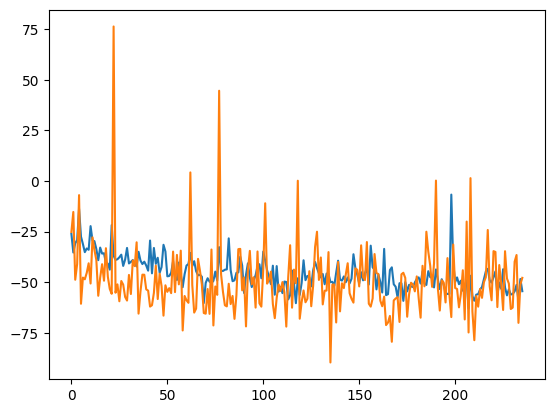

train_weighted_vae: enc
train: iter 0  trainloss -70.71767  validloss -74.41526±0.00000  bestvalidloss -74.41526  last_update 0
train: iter 1  trainloss -80.78201  validloss -85.68375±0.00000  bestvalidloss -85.68375  last_update 0
train: iter 2  trainloss -80.03291  validloss -80.63180±0.00000  bestvalidloss -85.68375  last_update 1
train: iter 3  trainloss -76.77613  validloss -48.67026±0.00000  bestvalidloss -85.68375  last_update 2
train: iter 4  trainloss -67.89771  validloss -52.25685±0.00000  bestvalidloss -85.68375  last_update 3
train: iter 5  trainloss -75.97387  validloss -62.05717±0.00000  bestvalidloss -85.68375  last_update 4
train: iter 6  trainloss -74.87342  validloss -74.72561±0.00000  bestvalidloss -85.68375  last_update 5
train: iter 7  trainloss -75.53248  validloss -83.85760±0.00000  bestvalidloss -85.68375  last_update 6
train: iter 8  trainloss -76.63394  validloss -87.34435±0.00000  bestvalidloss -87.34435  last_update 0
train: iter 9  trainloss -76.41933  vali

train: iter 79  trainloss -67.75804  validloss -71.68642±0.00000  bestvalidloss -96.43017  last_update 22
train: iter 80  trainloss -64.97903  validloss -77.77001±0.00000  bestvalidloss -96.43017  last_update 23
train: iter 81  trainloss -64.91329  validloss -51.35815±0.00000  bestvalidloss -96.43017  last_update 24
train: iter 82  trainloss -64.59071  validloss -67.04249±0.00000  bestvalidloss -96.43017  last_update 25
train: iter 83  trainloss -61.99242  validloss -44.88357±0.00000  bestvalidloss -96.43017  last_update 26
train: iter 84  trainloss -64.19101  validloss -59.73485±0.00000  bestvalidloss -96.43017  last_update 27
train: iter 85  trainloss -61.02808  validloss -45.75489±0.00000  bestvalidloss -96.43017  last_update 28
train: iter 86  trainloss -66.58845  validloss -57.27321±0.00000  bestvalidloss -96.43017  last_update 29
train: iter 87  trainloss -67.97462  validloss -92.95778±0.00000  bestvalidloss -96.43017  last_update 30
train: iter 88  trainloss -65.75017  validloss

train: iter 156  trainloss -59.36941  validloss -61.23097±0.00000  bestvalidloss -96.43017  last_update 99
train: iter 157  trainloss -58.19812  validloss -46.53494±0.00000  bestvalidloss -96.43017  last_update 100
train: fin


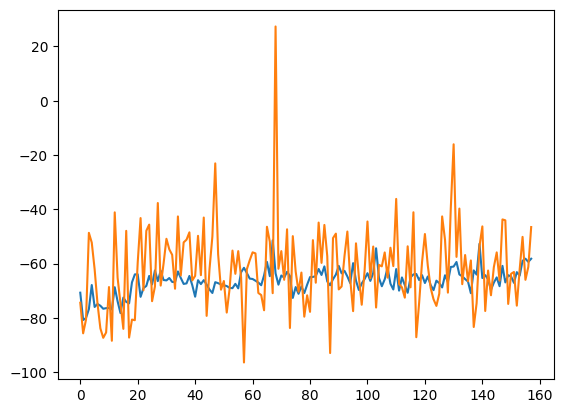

train_weighted_vae: dec
train: iter 0  trainloss -61.46351  validloss -62.82008±0.00000  bestvalidloss -62.82008  last_update 0
train: iter 1  trainloss -64.56054  validloss -53.21251±0.00000  bestvalidloss -62.82008  last_update 1
train: iter 2  trainloss -61.94685  validloss -36.27957±0.00000  bestvalidloss -62.82008  last_update 2
train: iter 3  trainloss -58.35806  validloss -46.73326±0.00000  bestvalidloss -62.82008  last_update 3
train: iter 4  trainloss -64.40350  validloss -47.01901±0.00000  bestvalidloss -62.82008  last_update 4
train: iter 5  trainloss -66.51344  validloss -38.43901±0.00000  bestvalidloss -62.82008  last_update 5
train: iter 6  trainloss -61.79482  validloss -46.50876±0.00000  bestvalidloss -62.82008  last_update 6
train: iter 7  trainloss -64.64446  validloss -41.53960±0.00000  bestvalidloss -62.82008  last_update 7
train: iter 8  trainloss -66.21681  validloss -58.13313±0.00000  bestvalidloss -62.82008  last_update 8
train: iter 9  trainloss -61.83826  vali

train: iter 78  trainloss -67.33944  validloss -45.23126±0.00000  bestvalidloss -62.82008  last_update 78
train: iter 79  trainloss -61.57568  validloss -40.82278±0.00000  bestvalidloss -62.82008  last_update 79
train: iter 80  trainloss -64.50470  validloss -59.43069±0.00000  bestvalidloss -62.82008  last_update 80
train: iter 81  trainloss -65.08734  validloss -52.00191±0.00000  bestvalidloss -62.82008  last_update 81
train: iter 82  trainloss -61.80398  validloss -46.51318±0.00000  bestvalidloss -62.82008  last_update 82
train: iter 83  trainloss -65.70581  validloss -36.97612±0.00000  bestvalidloss -62.82008  last_update 83
train: iter 84  trainloss -67.05571  validloss -30.57955±0.00000  bestvalidloss -62.82008  last_update 84
train: iter 85  trainloss -65.42976  validloss -38.46600±0.00000  bestvalidloss -62.82008  last_update 85
train: iter 86  trainloss -65.98541  validloss -7.09132±0.00000  bestvalidloss -62.82008  last_update 86
train: iter 87  trainloss -61.59313  validloss 

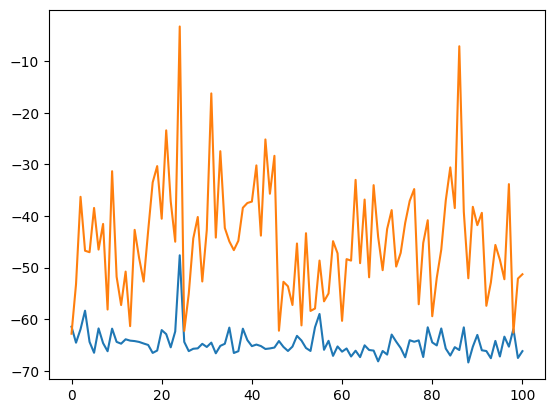

alpha 0.5 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

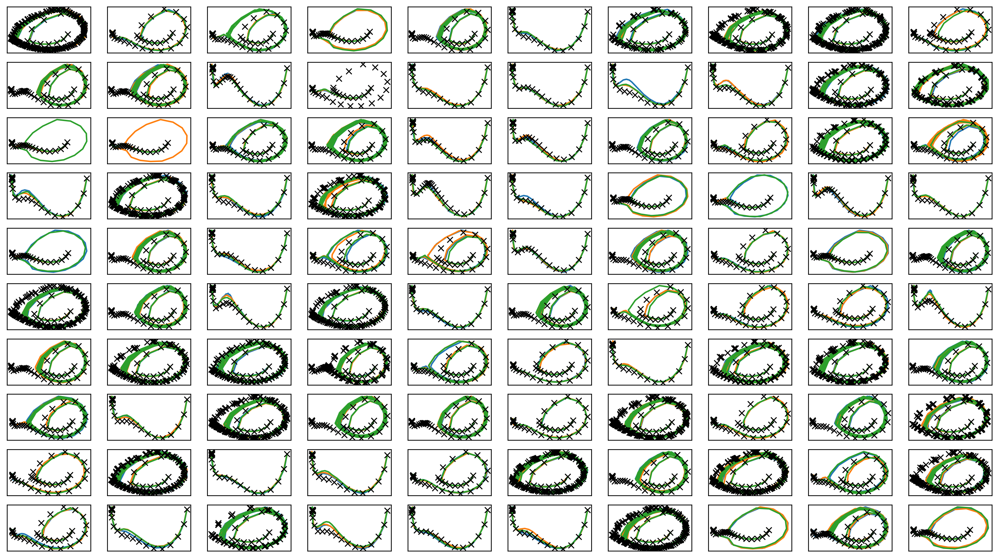

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter5.png")
print("実環境方策rollout vs Sim環境方策rollout")

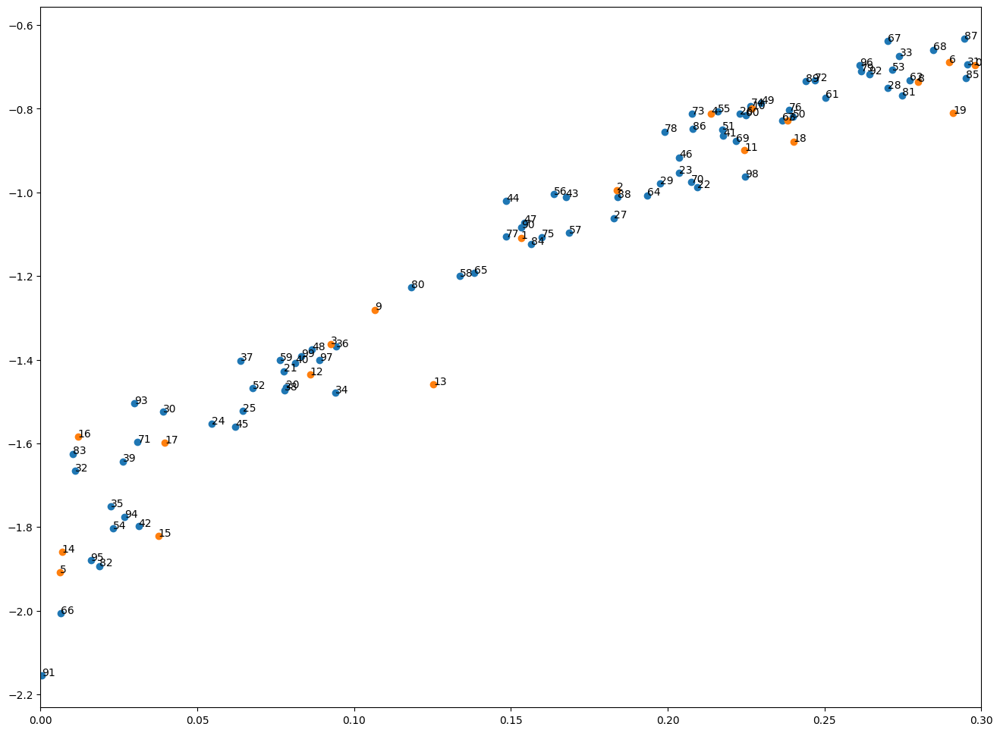

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-03-04 16:19:52.834745
